In [3]:
!pip install -U ydata-profiling[notebook]
import ydata_profiling as pp

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 3.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.0/679.0 kB 25.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.7/37.7 MB 29.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 11.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 400.1/400.1 kB 35.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 113.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 81.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.4/69.4 kB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 386.9/386.9 kB 36.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.5/133.5 kB 13.9 MB/s eta 0:00:00
  

In [12]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

# preprocessing
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, StratifiedKFold

# models
from sklearn.linear_model import LinearRegression, SGDRegressor, RidgeCV
from sklearn.svm import SVR, LinearSVR
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, ExtraTreesRegressor
from sklearn.ensemble import BaggingRegressor, AdaBoostRegressor, VotingRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.tree import DecisionTreeRegressor
import sklearn.model_selection
from sklearn.model_selection import cross_val_predict as cvp
from sklearn import metrics
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import xgboost as xgb
import lightgbm as lgbm
from sklearn.metrics import r2_score

# model tuning
from hyperopt import STATUS_OK, Trials, fmin, hp, tpe, space_eval

import warnings
warnings.filterwarnings("ignore")


In [57]:
valid_part = 0.3    #30% used for validation
pd.set_option('display.max_columns',100)  # pandas will display up to 100 columns

In [58]:
train0 = pd.read_csv("/content/drive/MyDrive/craigslistVehicles.csv")
train0.head(5)

,url,city,city_url,price,year,manufacturer,make,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,image_url,desc,lat,long
0,https://grandrapids.craigslist.org/cto/d/hasti...,"grand rapids, MI",https://grandrapids.craigslist.org,1500,2006.0,cadillac,cts,good,6 cylinders,gas,236000.0,clean,automatic,NaN,rwd,mid-size,coupe,blue,https://images.craigslist.org/00K0K_a9CZoZg2U8...,"2006 CtS Leather, Runs and drives Good.236k mil",42.643000,-85.293700
1,https://grandrapids.craigslist.org/cto/d/grand...,"grand rapids, MI",https://grandrapids.craigslist.org,8900,2009.0,lincoln,mkx,NaN,NaN,gas,119000.0,clean,automatic,NaN,NaN,NaN,NaN,NaN,https://images.craigslist.org/00a0a_9B4kPBDIWd...,"Selling our loaded 2009 Lincoln MKX with 119,0...",42.973700,-85.726500
2,https://grandrapids.craigslist.org/ctd/d/chesa...,"grand rapids, MI",https://grandrapids.craigslist.org,7995,2010.0,cadillac,srx premium collection,NaN,NaN,gas,129105.0,clean,automatic,3GYFNCEYXAS552363,NaN,NaN,NaN,NaN,https://images.craigslist.org/00X0X_8i0VRuk7Cv...,WE HAVE OVER 400 VEHICLES IN STOCK!\n\n View O...,43.186723,-84.163862
3,https://grandrapids.craigslist.org/ctd/d/chesa...,"grand rapids, MI",https://grandrapids.craigslist.org,6995,2007.0,NaN,hummer h3 4dr 4wd suv,NaN,NaN,gas,164296.0,clean,automatic,5GTDN13E478107380,NaN,NaN,NaN,NaN,https://images.craigslist.org/00b0b_ahkmUzr4cE...,WE HAVE OVER 400 VEHICLES IN STOCK!\n\n View O...,43.186723,-84.163862
4,https://grandrapids.craigslist.org/ctd/d/caled...,"grand rapids, MI",https://grandrapids.craigslist.org,20990,2010.0,ram,2500,excellent,6 cylinders,diesel,123213.0,clean,automatic,3D7UT2CL4AG113236,4wd,NaN,NaN,white,https://images.craigslist.org/00505_3DHY0kFrgb...,Great looking 2010 Ram 2500 ST w/6.7L 24V I6 4...,42.783714,-85.506777


In [59]:
DF=train0 #another file copied to data set

In [60]:
df=train0 #another file copied to data set

In [61]:
train0.columns #columns of train0

Index(['url', 'city', 'city_url', 'price', 'year', 'manufacturer', 'make',
       'condition', 'cylinders', 'fuel', 'odometer', 'title_status',
       'transmission', 'VIN', 'drive', 'size', 'type', 'paint_color',
       'image_url', 'desc', 'lat', 'long'],
      dtype='object')

In [62]:
train0.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 525839 entries, 0 to 525838
Data columns (total 22 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   url           525839 non-null  object 
 1   city          525839 non-null  object 
 2   city_url      525839 non-null  object 
 3   price         525839 non-null  int64  
 4   year          524399 non-null  float64
 5   manufacturer  501260 non-null  object 
 6   make          517201 non-null  object 
 7   condition     279881 non-null  object 
 8   cylinders     315439 non-null  object 
 9   fuel          521544 non-null  object 
 10  odometer      427248 non-null  float64
 11  title_status  523014 non-null  object 
 12  transmission  521572 non-null  object 
 13  VIN           305650 non-null  object 
 14  drive         374475 non-null  object 
 15  size          174519 non-null  object 
 16  type          376906 non-null  object 
 17  paint_color   354306 non-null  object 
 18  imag

dropping columns

In [64]:
drop_columns = ['url', 'city', 'city_url', 'make', 'title_status', 'VIN', 'size', 'image_url', 'desc', 'lat','long']
train0 = train0.drop(columns = drop_columns)

dataset head

In [65]:
train0 = train0.dropna()
train0.head(5)

,price,year,manufacturer,condition,cylinders,fuel,odometer,transmission,drive,type,paint_color
12,8000,2010.0,audi,good,6 cylinders,gas,150000.0,automatic,4wd,sedan,grey
28,9995,2011.0,subaru,excellent,4 cylinders,gas,113000.0,automatic,4wd,SUV,green
46,22900,2017.0,buick,excellent,6 cylinders,gas,49707.0,automatic,fwd,sedan,black
60,3295,2005.0,pontiac,good,6 cylinders,gas,78674.0,automatic,fwd,sedan,silver
65,48955,2016.0,cadillac,excellent,8 cylinders,gas,33210.0,automatic,4wd,SUV,black


categorical conversion

In [66]:
numerics = ['int8', 'int16', 'int32', 'int64', 'float16', 'float32', 'float64'] # Determination categorical features
categorical_columns = []    #categorical columns
features = train0.columns.values.tolist()
for col in features:
    if train0[col].dtype in numerics: continue        # Find categorical columns:
    categorical_columns.append(col)

for col in categorical_columns:       # Label Encoding categorical features
    if col in train0.columns:
        le = LabelEncoder()
        le.fit(list(train0[col].astype(str).values))
        train0[col] = le.transform(list(train0[col].astype(str).values))

In [67]:
train0['year'] = (train0['year']-1900).astype(int)    #	1900 subtracted  from the year column to reduce  numerical scale of the year feature
train0['odometer'] = train0['odometer'].astype(int)   # integer type value conversion

In [68]:
train0.info()

<class 'pandas.core.frame.DataFrame'>
Index: 64903 entries, 12 to 525807
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype
---  ------        --------------  -----
 0   price         64903 non-null  int64
 1   year          64903 non-null  int64
 2   manufacturer  64903 non-null  int64
 3   condition     64903 non-null  int64
 4   cylinders     64903 non-null  int64
 5   fuel          64903 non-null  int64
 6   odometer      64903 non-null  int64
 7   transmission  64903 non-null  int64
 8   drive         64903 non-null  int64
 9   type          64903 non-null  int64
 10  paint_color   64903 non-null  int64
dtypes: int64(11)
memory usage: 5.9 MB


In [69]:
train0['price'].value_counts()              #count of values

,count
price,
0,4636
1,1491
6995,757
5995,722
8995,696
...,...
4594,1
33525,1
23425,1


Outlier reduction

In [70]:
train0 = train0[train0['price'] > 1000]
train0 = train0[train0['price'] < 40000]      #keeps only some values and does away with outliers

train0['odometer'] = train0['odometer'] // 5000       # Rounded ['odometer'] to 5000
train0 = train0[train0['year'] > 110]

In [ ]:
train0.corr()

,price,year,manufacturer,condition,cylinders,fuel,odometer,transmission,drive,type,paint_color
price,1.000000,0.458124,-0.024179,0.061167,0.531244,-0.208566,-0.184752,0.105238,-0.267012,0.061335,0.030263
year,0.458124,1.000000,0.045498,0.111609,-0.078526,0.069939,-0.296953,0.036089,0.010158,0.026916,0.040059
manufacturer,-0.024179,0.045498,1.000000,-0.009447,-0.201032,-0.065246,-0.021403,0.026844,-0.101821,0.026859,-0.003125
condition,0.061167,0.111609,-0.009447,1.000000,0.016719,0.038039,-0.054486,0.121792,0.061101,0.028917,0.022872
cylinders,0.531244,-0.078526,-0.201032,0.016719,1.000000,-0.109350,0.066435,0.052527,-0.153713,0.096659,0.037153
fuel,-0.208566,0.069939,-0.065246,0.038039,-0.109350,1.000000,-0.089144,0.068673,0.096037,-0.132572,-0.042783
odometer,-0.184752,-0.296953,-0.021403,-0.054486,0.066435,-0.089144,1.000000,-0.074429,-0.046763,0.020417,0.022202
transmission,0.105238,0.036089,0.026844,0.121792,0.052527,0.068673,-0.074429,1.000000,0.064781,-0.007124,-0.026939
drive,-0.267012,0.010158,-0.101821,0.061101,-0.153713,0.096037,-0.046763,0.064781,1.000000,0.118371,0.073252
type,0.061335,0.026916,0.026859,0.028917,0.096659,-0.132572,0.020417,-0.007124,0.118371,1.000000,0.069675


In [55]:
train0.describe()

,year,odometer,lat,long
count,419517.000000,3.417520e+05,410907.000000,410907.000000
mean,2009.365377,1.012234e+05,38.473341,-94.268811
std,8.994016,1.048994e+05,5.900334,17.751213
min,1900.000000,0.000000e+00,-83.668334,-176.748047
25%,2006.000000,4.906700e+04,34.688400,-108.386684
50%,2011.000000,9.428700e+04,39.213214,-88.583707
75%,2015.000000,1.380000e+05,42.447521,-80.992110
max,2020.000000,1.000000e+07,71.525358,132.078349


Profiling report

In [ ]:
pp.ProfileReport(train0)      # profiling report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 11/11 [00:00<00:00, 25.00it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [71]:
target_name = 'price'
train_target0 = train0[target_name]             #settin gtrain variable
train0 = train0.drop([target_name], axis=1)

In [72]:
train0, test0, train_target0, test_target0 = train_test_split(train0, train_target0, test_size=0.2, random_state=0)   #train test split

In [73]:
train0b = train0
train_target0b = train_target0

trainb, testb, targetb, target_testb = train_test_split(train0b, train_target0b, test_size=valid_part, random_state=0)      # Synthesis valid as test for selection models

In [74]:
scaler = StandardScaler()       #standard scaler
train0 = pd.DataFrame(scaler.fit_transform(train0), columns = train0.columns)

In [53]:
train0.head(3)

,url,city,city_url,year,manufacturer,make,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,image_url,desc,lat,long
260374,https://eastnc.craigslist.org/ctd/d/greenville...,eastern NC,https://eastnc.craigslist.org,2006.0,toyota,corolla,NaN,NaN,gas,NaN,clean,automatic,NaN,NaN,NaN,NaN,NaN,https://images.craigslist.org/00K0K_eoCkOs7PIE...,2006 Toyota Corolla 4dr Automatic Cold Air 4cy...,35.619200,-77.397500
300983,https://grandisland.craigslist.org/ctd/d/gretn...,"grand island, NE",https://grandisland.craigslist.org,2006.0,ram,2500 4x4 slt 4dr mega,NaN,NaN,gas,123257.0,clean,automatic,3D7KS29C96G160657,NaN,NaN,NaN,NaN,https://images.craigslist.org/00o0o_b4oJRTbWOp...,2006Â DodgeÂ Ram 2500 4x4 SLT 4dr Mega Cab 6.3...,41.130325,-96.253158
509002,https://vermont.craigslist.org/cto/d/sharon-20...,vermont,https://vermont.craigslist.org,2008.0,subaru,legacy wagon,good,4 cylinders,gas,145000.0,clean,automatic,NaN,4wd,NaN,wagon,NaN,https://images.craigslist.org/00J0J_gJgfZnL14w...,2008 Subaru AWD Legacy Wagon is up for sale wi...,43.774800,-72.424300


In [345]:
train, test, target, target_test = train_test_split(train0, train_target0, test_size=valid_part, random_state=0)

In [346]:
test.head(3)

,year,manufacturer,condition,cylinders,fuel,odometer,transmission,drive,type,paint_color
44567,-0.045159,0.165006,1.595253,0.427812,0.165521,-0.469822,-0.277197,-0.946534,-0.042951,1.076444
7230,2.225269,-0.205262,-0.847094,0.427812,0.165521,-0.672658,-0.277197,0.429470,-0.282244,-1.133325
6341,-1.407417,-0.112695,-0.847094,-1.141380,0.165521,0.240104,-0.277197,0.429470,0.674928,0.830914


In [ ]:
len(train0)

49200

#setting lists for accuracy

In [347]:
acc_train_r2 = []
acc_test_r2 = []
acc_train_d = []            #setting lists for accuracy
acc_test_d = []
acc_train_rmse = []
acc_test_rmse = []

In [349]:
def acc_d(y_meas, y_pred):

    return mean_absolute_error(y_meas, y_pred)*len(y_meas)/sum(abs(y_meas))        # Relative error between predicted y_pred and measured y_meas values

def acc_rmse(y_meas, y_pred):

    return (mean_squared_error(y_meas, y_pred))**0.5            # RMSE between predicted y_pred and measured y_meas values

In [21]:
def acc_boosting_model(num,model,train,test,num_iteration=0):


    global acc_train_r2, acc_test_r2, acc_train_d, acc_test_d, acc_train_rmse, acc_test_rmse          # Using global lists to store accuracy metrics across multiple models


    if num_iteration > 0:
        ytrain = model.predict(train, num_iteration = num_iteration)
        ytest = model.predict(test, num_iteration = num_iteration)    # Predicting on train and test data with or without specified num_iteration
    else:
        ytrain = model.predict(train)
        ytest = model.predict(test)


    print('target = ', targetb[:5].values)
    print('ytrain = ', ytrain[:5]) # first 5 values of actual vs predicted for train dat


    acc_train_r2_num = round(r2_score(targetb, ytrain) * 100, 2)
    print('acc(r2_score) for train =', acc_train_r2_num) #store R2 score for training data
    acc_train_r2.insert(num, acc_train_r2_num)


    acc_train_d_num = round(acc_d(targetb, ytrain) * 100, 2)
    print('acc(relative error) for train =', acc_train_d_num)     # Calculate and store relative error for training data
    acc_train_d.insert(num, acc_train_d_num)


    acc_train_rmse_num = round(acc_rmse(targetb, ytrain) * 100, 2)     # Calculate and store RMSE for training data
    print('acc(rmse) for train =', acc_train_rmse_num)
    acc_train_rmse.insert(num, acc_train_rmse_num)

    # Show first 5 values of actual vs predicted for test data
    print('target_test =', target_testb[:5].values)
    print('ytest =', ytest[:5])


    acc_test_r2_num = round(r2_score(target_testb, ytest) * 100, 2)
    print('acc(r2_score) for test =', acc_test_r2_num)    # Calculate and store R2 score for test data
    acc_test_r2.insert(num, acc_test_r2_num)


    acc_test_d_num = round(acc_d(target_testb, ytest) * 100, 2)
    print('acc(relative error) for test =', acc_test_d_num)  # Calculate and store relative error for test data
    acc_test_d.insert(num, acc_test_d_num)

    acc_test_rmse_num = round(acc_rmse(target_testb, ytest) * 100, 2)
    print('acc(rmse) for test =', acc_test_rmse_num)
    acc_test_rmse.insert(num, acc_test_rmse_num)
    # Calculate and store RMSE for test data

In [352]:
def acc_model(num, model, train, test):
    # Calculation of accuracy of model from Sklearn by different metrics
    # global variables to store performance scores across models
    global acc_train_r2, acc_test_r2, acc_train_d, acc_test_d, acc_train_rmse, acc_test_rmse

    # Predict on training and test data
    ytrain = model.predict(train)
    ytest = model.predict(test)


    print('target = ', target[:5].values)    # Print first 5 true vs predicted values for training data
    print('ytrain = ', ytrain[:5])


    acc_train_r2_num = round(r2_score(target, ytrain) * 100, 2)
    print('acc(r2_score) for train =', acc_train_r2_num) # Compute and store R² score for training data
    acc_train_r2.insert(num, acc_train_r2_num)


    acc_train_d_num = round(acc_d(target, ytrain) * 100, 2)
    print('acc(relative error) for train =', acc_train_d_num)# Compute and store relative error for training data
    acc_train_d.insert(num, acc_train_d_num)


    acc_train_rmse_num = round(acc_rmse(target, ytrain) * 100, 2)
    print('acc(rmse) for train =', acc_train_rmse_num)# Compute and store relative error for training data
    acc_train_rmse.insert(num, acc_train_rmse_num)


    print('target_test =', target_test[:5].values)
    print('ytest =', ytest[:5])# Compute and store relative error for training data

    acc_test_r2_num = round(r2_score(target_test, ytest) * 100, 2)    # Compute and store relative error for test data
    print('acc(r2_score) for test =', acc_test_r2_num)
    acc_test_r2.insert(num, acc_test_r2_num)


    acc_test_d_num = round(acc_d(target_test, ytest) * 100, 2)
    print('acc(relative error) for test =', acc_test_d_num)
    acc_test_d.insert(num, acc_test_d_num)    # Compute and store relative error for test data


    acc_test_rmse_num = round(acc_rmse(target_test, ytest) * 100, 2)
    print('acc(rmse) for test =', acc_test_rmse_num)    # Compute and store RMSE for test data
    acc_test_rmse.insert(num, acc_test_rmse_num)

MOdels for fitting and predicting data

In [358]:
# linear regression model
linreg = LinearRegression()
linreg.fit(train, target)
acc_model(0,linreg,train,test)

target =  [14888  8995 16990  5600  5490]
ytrain =  [17220.8844431   8397.2939732  17733.57593104 10134.9269719
  6283.88038457]
acc(r2_score) for train = 61.64
acc(relative error) for train = 23.91
acc(rmse) for train = 534865.15
target_test = [38000 31550  5900 13500 35000]
ytest = [20341.93475801 27356.28728167  4431.23183339 19550.04053874
 24919.25787533]
acc(r2_score) for test = 58.44
acc(relative error) for test = 23.89
acc(rmse) for test = 555802.12


In [359]:
#support vextor model
svr = SVR()
svr.fit(train, target)
acc_model(1,svr,train,test)

target =  [14888  8995 16990  5600  5490]
ytrain =  [15217.26259365 13081.93378758 15591.30587964 13563.74970446
 12526.56611499]
acc(r2_score) for train = 14.88
acc(relative error) for train = 37.14
acc(rmse) for train = 796758.93
target_test = [38000 31550  5900 13500 35000]
ytest = [15987.95742866 16598.27499562 12663.40871752 15593.55138322
 16346.69567724]
acc(r2_score) for test = 14.56
acc(relative error) for test = 36.92
acc(rmse) for test = 796920.98


In [360]:
linear_svr = LinearSVR()    #linear support vector model
linear_svr.fit(train, target)
acc_model(2,linear_svr,train,test)

target =  [14888  8995 16990  5600  5490]
ytrain =  [13778.64891635  7646.18071821 14578.18351653  8823.19339048
  6005.04646258]
acc(r2_score) for train = 43.92
acc(relative error) for train = 27.62
acc(rmse) for train = 646709.7
target_test = [38000 31550  5900 13500 35000]
ytest = [16974.80245781 21686.30764548  4660.360484   15824.50608558
 20512.68810845]
acc(r2_score) for test = 35.54
acc(relative error) for test = 27.7
acc(rmse) for test = 692205.98


In [361]:
mlp = MLPRegressor()        #mlpregression model
param_grid = {'hidden_layer_sizes': [i for i in range(2,20)],
              'activation': ['relu'],
              'solver': ['adam'],
              'learning_rate': ['constant'],
              'learning_rate_init': [0.01],
              'power_t': [0.5],
              'alpha': [0.0001],
              'max_iter': [1000],
              'early_stopping': [True],
              'warm_start': [False]}      #parameters
mlp_GS = GridSearchCV(mlp, param_grid=param_grid,
                   cv=2, verbose=True, pre_dispatch='2*n_jobs')
mlp_GS.fit(train, target)
acc_model(3,mlp_GS,train,test)

Fitting 2 folds for each of 18 candidates, totalling 36 fits
target =  [14888  8995 16990  5600  5490]
ytrain =  [14078.47979247  8178.90816892 18595.30089991  8522.68894983
  6688.31302101]
acc(r2_score) for train = 74.34
acc(relative error) for train = 19.13
acc(rmse) for train = 437435.97
target_test = [38000 31550  5900 13500 35000]
ytest = [22253.52444789 25198.67786799  6803.29750887 17688.97126527
 29614.5119105 ]
acc(r2_score) for test = 74.07
acc(relative error) for test = 19.0
acc(rmse) for test = 439011.71


In [362]:
sgd = SGDRegressor()      #sgd regression model
sgd.fit(train, target)
acc_model(4,sgd,train,test)

target =  [14888  8995 16990  5600  5490]
ytrain =  [16772.68006017  8543.43685452 18146.94548475  9766.16880335
  6195.32000717]
acc(r2_score) for train = 60.75
acc(relative error) for train = 23.47
acc(rmse) for train = 541018.21
target_test = [38000 31550  5900 13500 35000]
ytest = [20563.02516711 27281.60382866  4442.2315172  19344.17023915
 24805.3892409 ]
acc(r2_score) for test = 50.77
acc(relative error) for test = 23.57
acc(rmse) for test = 604919.22


In [363]:
decision_tree = DecisionTreeRegressor()
decision_tree.fit(train, target)      #decision tree model
acc_model(5,decision_tree,train,test)

target =  [14888  8995 16990  5600  5490]
ytrain =  [11944.    8869.75 15996.25  5600.    5490.  ]
acc(r2_score) for train = 99.31
acc(relative error) for train = 0.96
acc(rmse) for train = 71730.45
target_test = [38000 31550  5900 13500 35000]
ytest = [38000.         33500.          7131.66666667 11500.
 20999.        ]
acc(r2_score) for test = 76.59
acc(relative error) for test = 14.41
acc(rmse) for test = 417149.91


In [364]:
random_forest = RandomForestRegressor()
random_forest.fit(train, target)
                                      #random forest model
acc_model(6,random_forest,train,test)

target =  [14888  8995 16990  5600  5490]
ytrain =  [11728.4575      8888.74306153 15911.70321429  6017.3
  5547.55      ]
acc(r2_score) for train = 97.53
acc(relative error) for train = 4.97
acc(rmse) for train = 135787.11
target_test = [38000 31550  5900 13500 35000]
ytest = [33041.91333333 28859.34        7114.25734127 16737.07833333
 30369.2325    ]
acc(r2_score) for test = 86.09
acc(relative error) for test = 12.09
acc(rmse) for test = 321528.2


In [365]:
acc_model(6,random_forest,train,test)     #acc model

target =  [14888  8995 16990  5600  5490]
ytrain =  [11728.4575      8888.74306153 15911.70321429  6017.3
  5547.55      ]
acc(r2_score) for train = 97.53
acc(relative error) for train = 4.97
acc(rmse) for train = 135787.11
target_test = [38000 31550  5900 13500 35000]
ytest = [33041.91333333 28859.34        7114.25734127 16737.07833333
 30369.2325    ]
acc(r2_score) for test = 86.09
acc(relative error) for test = 12.09
acc(rmse) for test = 321528.2


In [366]:
# --- XGBoost (fixed & faster) ---
import numpy as np
import xgboost as xgb
from sklearn.model_selection import GridSearchCV

# ensure numeric dtypes
X_tr = trainb.astype(np.float32)
y_tr = targetb.astype(np.float32)
X_te = testb.astype(np.float32)

# correct estimator construction (no dict as positional arg)
xgb_clf = xgb.XGBRegressor(
    objective='reg:squarederror',
    tree_method='hist',
    eval_metric='rmse',
    n_jobs=-1,
    random_state=42
)

parameters = {
    'n_estimators': [60, 100, 120, 140],
    'learning_rate': [0.01, 0.1],
    'max_depth': [5, 7],
    'reg_lambda': [0.5],
}

# lighter CV to avoid long runtimes (use 3 folds; switch to 5 later if you want)
xgb_reg = GridSearchCV(
    estimator=xgb_clf,
    param_grid=parameters,
    cv=3,
    n_jobs=-1,
    scoring='neg_root_mean_squared_error',
    verbose=1
)

xgb_reg.fit(X_tr, y_tr)

print(f"Best CV score (neg RMSE): {xgb_reg.best_score_:.4f}")
print("Best parameters set:", xgb_reg.best_params_)

# evaluate with your helper (works with GridSearchCV since it exposes predict)
acc_boosting_model(7, xgb_reg, X_tr, X_te)

Fitting 3 folds for each of 16 candidates, totalling 48 fits
Best CV score (neg RMSE): -3429.4698
Best parameters set: {'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 140, 'reg_lambda': 0.5}
target =  [14888  8995 16990  5600  5490]
ytrain =  [13018.524   8349.328  17175.559   7266.0293  5931.6436]
acc(r2_score) for train = 87.72
acc(relative error) for train = 12.92
acc(rmse) for train = 302631.95
target_test = [38000 31550  5900 13500 35000]
ytest = [25694.27   26631.94    6427.5215 15530.893  31539.184 ]
acc(r2_score) for test = 84.74
acc(relative error) for test = 14.12
acc(rmse) for test = 336763.85


In [367]:
Xtrain, Xval, Ztrain, Zval = train_test_split(trainb, targetb, test_size=0.2, random_state=0)
train_set = lgbm.Dataset(Xtrain, Ztrain)    #lgbm model being buiult here
valid_set = lgbm.Dataset(Xval, Zval)

In [368]:
params = {
        'boosting_type':'gbdt',
        'objective': 'regression',
        'num_leaves': 31,
        'learning_rate': 0.01,
        'max_depth': -1,
        'subsample': 0.8,
        'bagging_fraction' : 1,
        'max_bin' : 5000 ,
        'bagging_freq': 20,
        'colsample_bytree': 0.6,
        'metric': 'rmse',
        'min_split_gain': 0.5,
        'min_child_weight': 1,
        'min_child_samples': 10,
        'scale_pos_weight':1,
        'zero_as_missing': False,
        'seed':0,
    }
modelL = lgbm.train(params, train_set = train_set, num_boost_round=10000,
                    valid_sets=valid_set)

[LightGBM] [Warning] bagging_fraction is set=1, subsample=0.8 will be ignored. Current value: bagging_fraction=1
[LightGBM] [Warning] bagging_fraction is set=1, subsample=0.8 will be ignored. Current value: bagging_fraction=1
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011023 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 167
[LightGBM] [Info] Number of data points in the train set: 27552, number of used features: 10
[LightGBM] [Warning] bagging_fraction is set=1, subsample=0.8 will be ignored. Current value: bagging_fraction=1
[LightGBM] [Info] Start training from score 16761.821828


accuracy of boosting model

In [369]:
acc_boosting_model(8,modelL,trainb,testb,modelL.best_iteration)

target =  [14888  8995 16990  5600  5490]
ytrain =  [13301.4098337   8482.93923512 16712.52039059  7234.91529452
  5927.61967018]
acc(r2_score) for train = 89.87
acc(relative error) for train = 11.48
acc(rmse) for train = 274875.83
target_test = [38000 31550  5900 13500 35000]
ytest = [28705.7518182  25970.80230073  6511.07035402 14006.15210222
 35579.45865085]
acc(r2_score) for test = 85.77
acc(relative error) for test = 13.41
acc(rmse) for test = 325263.74


Feature importance plat

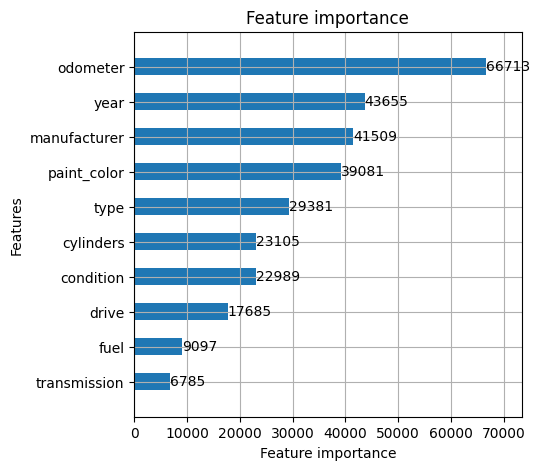

In [370]:
fig =  plt.figure(figsize = (5,5))
axes = fig.add_subplot(111)
lgbm.plot_importance(modelL,ax = axes,height = 0.5)
plt.show();
plt.close()

In [371]:
def hyperopt_gb_score(params):        # Define the objective function to minimize (maximize negative CV score)
    clf = GradientBoostingRegressor(**params)
    current_score = cross_val_score(clf, train, target, cv=10).mean()
    print(current_score, params)
    return current_score

space_gb = {
            'n_estimators': hp.choice('n_estimators', range(100, 1000)),
            'max_depth': hp.choice('max_depth', np.arange(2, 3, dtype=int))
        }

best = fmin(fn=hyperopt_gb_score, space=space_gb, algo=tpe.suggest, max_evals=1)
print('best:')
print(best)

0.7871024611779583
{'max_depth': np.int64(2), 'n_estimators': 320}
100%|██████████| 1/1 [00:53<00:00, 53.05s/trial, best loss: 0.7871024611779583]
best:
{'max_depth': np.int64(0), 'n_estimators': np.int64(220)}


In [372]:
params = space_eval(space_gb, best)
params

{'max_depth': np.int64(2), 'n_estimators': 320}

In [373]:
gradient_boosting = GradientBoostingRegressor(**params)
gradient_boosting.fit(train, target)
acc_model(9,gradient_boosting,train,test)     #gradient boosting

target =  [14888  8995 16990  5600  5490]
ytrain =  [14172.34264617  8320.97647164 18029.38011596  7790.02057174
  7402.77790524]
acc(r2_score) for train = 79.09
acc(relative error) for train = 17.35
acc(rmse) for train = 394847.46
target_test = [38000 31550  5900 13500 35000]
ytest = [22348.76713285 24982.82096191  5761.07601764 17637.88892834
 30416.40947564]
acc(r2_score) for test = 78.89
acc(relative error) for test = 17.22
acc(rmse) for test = 396100.28


In [374]:
ridge = RidgeCV(cv=5)#ridge cv
ridge.fit(train, target)
acc_model(10,ridge,train,test)

target =  [14888  8995 16990  5600  5490]
ytrain =  [17220.74260172  8399.64685999 17733.15673909 10137.097247
  6286.78880675]
acc(r2_score) for train = 61.64
acc(relative error) for train = 23.91
acc(rmse) for train = 534865.19
target_test = [38000 31550  5900 13500 35000]
ytest = [20341.45202939 27352.66613376  4434.95517174 19549.19011371
 24916.23870525]
acc(r2_score) for test = 58.44
acc(relative error) for test = 23.89
acc(rmse) for test = 555793.6


In [375]:
bagging = BaggingRegressor()
bagging.fit(train, target)#bagging
acc_model(11,bagging,train,test)

target =  [14888  8995 16990  5600  5490]
ytrain =  [12620.56666667  8848.8242915  16260.25        5748.9
  5463.9       ]
acc(r2_score) for train = 96.8
acc(relative error) for train = 5.44
acc(rmse) for train = 154498.65
target_test = [38000 31550  5900 13500 35000]
ytest = [29172.2        30751.6         7058.7        17530.46666667
 34124.73333333]
acc(r2_score) for test = 84.92
acc(relative error) for test = 12.64
acc(rmse) for test = 334753.32


In [354]:
etr = ExtraTreesRegressor()
etr.fit(train, target)
acc_model(12,etr,train,test)#extra trees regression

target =  [14888  8995 16990  5600  5490]
ytrain =  [11944.    8869.75 15996.25  5600.    5490.  ]
acc(r2_score) for train = 99.31
acc(relative error) for train = 0.96
acc(rmse) for train = 71730.47
target_test = [38000 31550  5900 13500 35000]
ytest = [38000.         27450.23333333  7131.66666667 16731.87
 29365.6075    ]
acc(r2_score) for test = 85.52
acc(relative error) for test = 11.46
acc(rmse) for test = 328070.12


In [376]:
Ada_Boost = AdaBoostRegressor()#adaboodting
Ada_Boost.fit(train, target)
acc_model(13,Ada_Boost,train,test)

target =  [14888  8995 16990  5600  5490]
ytrain =  [15841.7637781  11220.06856263 19223.47849788 11220.06856263
 11220.06856263]
acc(r2_score) for train = 63.6
acc(relative error) for train = 25.04
acc(rmse) for train = 521011.87
target_test = [38000 31550  5900 13500 35000]
ytest = [22189.42658875 22685.34736423 10173.611334   20723.75779631
 28043.14455917]
acc(r2_score) for test = 63.45
acc(relative error) for test = 24.82
acc(rmse) for test = 521243.21


In [377]:
Voting_Reg = VotingRegressor(estimators=[('lin', linreg), ('ridge', ridge), ('sgd', sgd)])
Voting_Reg.fit(train, target)   #voting regressor
acc_model(14,Voting_Reg,train,test)

target =  [14888  8995 16990  5600  5490]
ytrain =  [17445.83766302  8235.2656359  17380.55485722 10141.64317356
  6165.68524929]
acc(r2_score) for train = 60.93
acc(relative error) for train = 24.43
acc(rmse) for train = 539805.33
target_test = [38000 31550  5900 13500 35000]
ytest = [19848.0533755  27541.17204147  4197.96774143 19420.65930883
 25254.63363026]
acc(r2_score) for test = 60.51
acc(relative error) for test = 24.28
acc(rmse) for test = 541805.16


In [378]:

for lst in (acc_train_r2, acc_test_r2, acc_train_d, acc_test_d, acc_train_rmse, acc_test_rmse):
    if len(lst) > 15:         # drop the extra element at index 6 (the 2nd Random Forest insert)
        lst.pop(6)

models = pd.DataFrame({
    'Model': ['Linear Regression', 'Support Vector Machines', 'Linear SVR',
              'MLPRegressor', 'Stochastic Gradient Decent',
              'Decision Tree Regressor', 'Random Forest',  'XGB', 'LGBM',
              'GradientBoostingRegressor', 'RidgeRegressor', 'BaggingRegressor', 'ExtraTreesRegressor',
              'AdaBoostRegressor', 'VotingRegressor'],
    'r2_train': acc_train_r2,
    'r2_test': acc_test_r2,
    'd_train': acc_train_d,
    'd_test': acc_test_d,
    'rmse_train': acc_train_rmse,
    'rmse_test': acc_test_rmse
})

In [379]:
pd.options.display.float_format = '{:,.2f}'.format

## Prediction accuracy Model comparison

r squared test

In [ ]:
print('Prediction accuracy for models by R2 criterion - r2_test')
models.sort_values(by=['r2_test', 'r2_train'], ascending=False)

Prediction accuracy for models by R2 criterion - r2_test


,Model,r2_train,r2_test,d_train,d_test,rmse_train,rmse_test
14,VotingRegressor,97.52,86.05,4.97,12.11,"135,914.69","321,994.40"
7,XGB,89.87,85.77,11.48,13.41,"274,875.83","325,263.74"
11,BaggingRegressor,99.31,85.52,0.96,11.47,"71,730.47","328,083.02"
10,RidgeRegressor,96.80,84.89,5.44,12.67,"154,502.49","335,116.01"
6,Random Forest,87.72,84.74,12.92,14.12,"302,631.95","336,763.85"
8,LGBM,79.99,79.69,16.90,16.81,"386,300.78","388,507.78"
5,Decision Tree Regressor,99.31,76.57,0.96,14.42,"71,730.45","417,300.29"
3,MLPRegressor,74.37,74.25,19.16,19.02,"437,189.01","437,504.71"
12,ExtraTreesRegressor,60.31,60.47,26.57,26.28,"544,067.43","542,038.23"
4,Stochastic Gradient Decent,61.33,60.13,24.23,24.11,"537,033.66","544,386.17"


d test

In [ ]:
print('Prediction accuracy for models by relative error - d_test')
models.sort_values(by=['d_test', 'd_train'], ascending=True)

Prediction accuracy for models by relative error - d_test


,Model,r2_train,r2_test,d_train,d_test,rmse_train,rmse_test
11,BaggingRegressor,99.31,85.52,0.96,11.47,"71,730.47","328,083.02"
14,VotingRegressor,97.52,86.05,4.97,12.11,"135,914.69","321,994.40"
10,RidgeRegressor,96.80,84.89,5.44,12.67,"154,502.49","335,116.01"
7,XGB,89.87,85.77,11.48,13.41,"274,875.83","325,263.74"
6,Random Forest,87.72,84.74,12.92,14.12,"302,631.95","336,763.85"
5,Decision Tree Regressor,99.31,76.57,0.96,14.42,"71,730.45","417,300.29"
8,LGBM,79.99,79.69,16.90,16.81,"386,300.78","388,507.78"
3,MLPRegressor,74.37,74.25,19.16,19.02,"437,189.01","437,504.71"
0,Linear Regression,61.64,58.44,23.91,23.89,"534,865.15","555,802.12"
9,GradientBoostingRegressor,61.64,58.44,23.91,23.89,"534,865.19","555,793.60"


rmse error

In [ ]:
print('Prediction accuracy for models by RMSE - rmse_test')
models.sort_values(by=['rmse_test', 'rmse_train'], ascending=True)

Prediction accuracy for models by RMSE - rmse_test


,Model,r2_train,r2_test,d_train,d_test,rmse_train,rmse_test
14,VotingRegressor,97.52,86.05,4.97,12.11,"135,914.69","321,994.40"
7,XGB,89.87,85.77,11.48,13.41,"274,875.83","325,263.74"
11,BaggingRegressor,99.31,85.52,0.96,11.47,"71,730.47","328,083.02"
10,RidgeRegressor,96.80,84.89,5.44,12.67,"154,502.49","335,116.01"
6,Random Forest,87.72,84.74,12.92,14.12,"302,631.95","336,763.85"
8,LGBM,79.99,79.69,16.90,16.81,"386,300.78","388,507.78"
5,Decision Tree Regressor,99.31,76.57,0.96,14.42,"71,730.45","417,300.29"
3,MLPRegressor,74.37,74.25,19.16,19.02,"437,189.01","437,504.71"
12,ExtraTreesRegressor,60.31,60.47,26.57,26.28,"544,067.43","542,038.23"
4,Stochastic Gradient Decent,61.33,60.13,24.23,24.11,"537,033.66","544,386.17"


# Plot of Rsquared

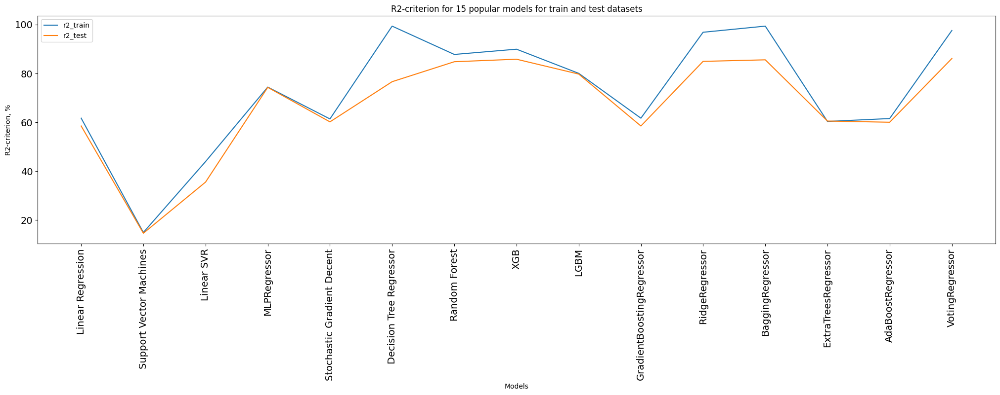

In [ ]:
plt.figure(figsize=[25,6])
xx = models['Model']
plt.tick_params(labelsize=14)
plt.plot(xx, models['r2_train'], label = 'r2_train')
plt.plot(xx, models['r2_test'], label = 'r2_test')
plt.legend()
plt.title('R2-criterion for 15 popular models for train and test datasets')
plt.xlabel('Models')
plt.ylabel('R2-criterion, %')
plt.xticks(xx, rotation='vertical')
plt.savefig('graph.png')
plt.show()

# Plot of relative erroe

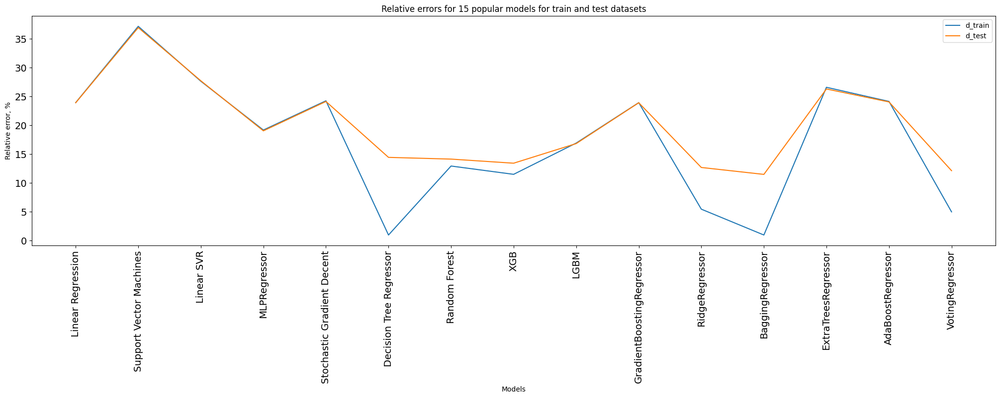

In [ ]:
# Plot
plt.figure(figsize=[25,6])
xx = models['Model']
plt.tick_params(labelsize=14)
plt.plot(xx, models['d_train'], label = 'd_train')
plt.plot(xx, models['d_test'], label = 'd_test')
plt.legend()
plt.title('Relative errors for 15 popular models for train and test datasets')
plt.xlabel('Models')
plt.ylabel('Relative error, %')
plt.xticks(xx, rotation='vertical')
plt.savefig('graph.png')
plt.show()

## Plot of RMSE

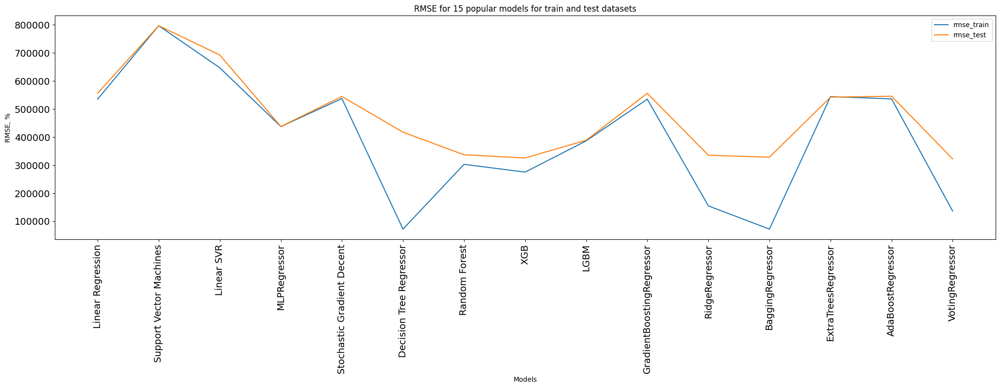

In [ ]:
# Plot
plt.figure(figsize=[25,6])
xx = models['Model']
plt.tick_params(labelsize=14)
plt.plot(xx, models['rmse_train'], label = 'rmse_train')
plt.plot(xx, models['rmse_test'], label = 'rmse_test')
plt.legend()
plt.title('RMSE for 15 popular models for train and test datasets')
plt.xlabel('Models')
plt.ylabel('RMSE, %')
plt.xticks(xx, rotation='vertical')
plt.savefig('graph.png')
plt.show()

Bar charts r squared comprison

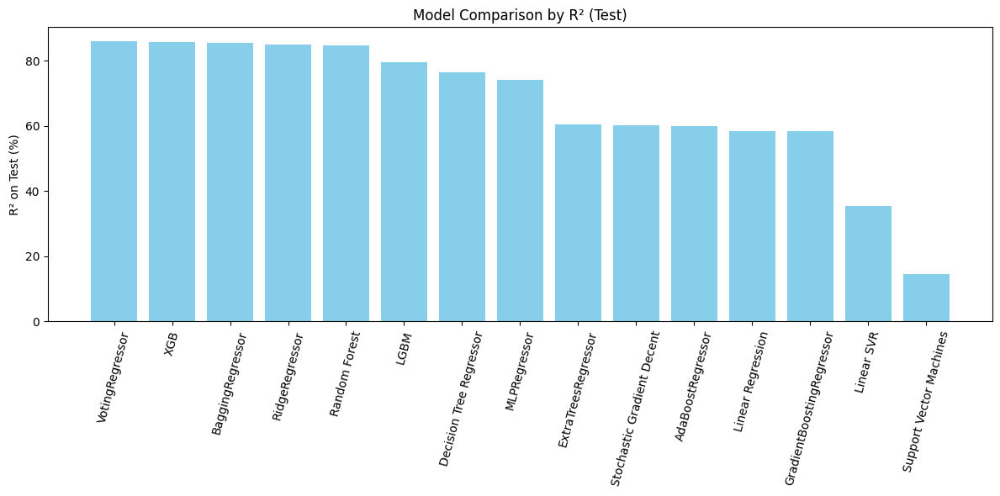

In [ ]:
# R2 Test Scores - Sorted Bar Chart
plt.figure(figsize=(12,6))
sorted_models = models.sort_values('r2_test', ascending=False)
plt.bar(sorted_models['Model'], sorted_models['r2_test'], color='skyblue')
plt.xticks(rotation=75)
plt.ylabel('R² on Test (%)')
plt.title('Model Comparison by R² (Test)')
plt.tight_layout()
plt.show()

Train v test gap(overfit check)

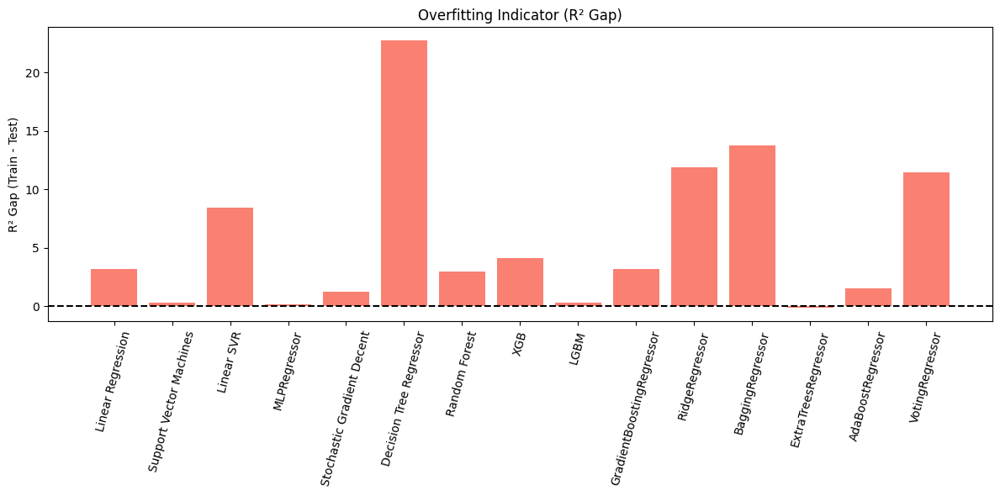

In [ ]:
models['r2_gap'] = models['r2_train'] - models['r2_test']
plt.figure(figsize=(12,6))
plt.bar(models['Model'], models['r2_gap'], color='salmon')
plt.xticks(rotation=75)
plt.ylabel('R² Gap (Train - Test)')
plt.title('Overfitting Indicator (R² Gap)')
plt.axhline(0, color='black', linestyle='--')
plt.tight_layout()
plt.show()

heatmap of metrics

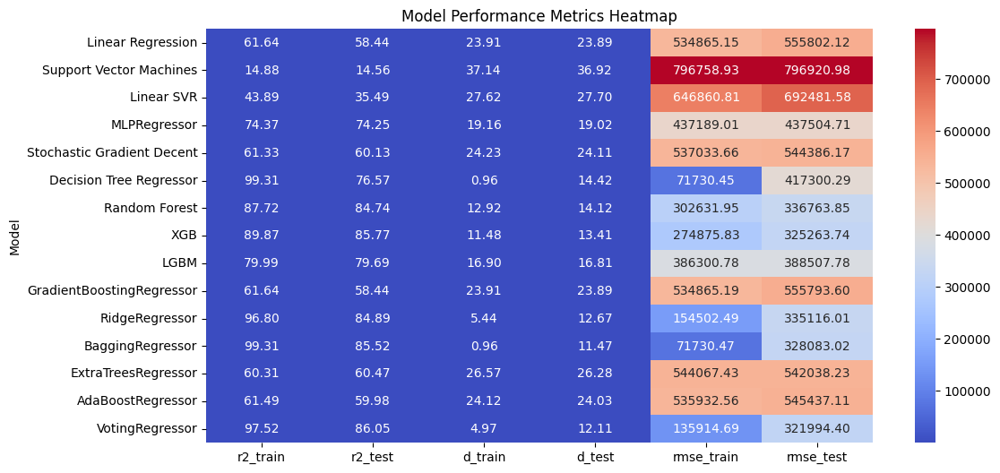

In [ ]:
import seaborn as sns

metric_cols = ['r2_train', 'r2_test', 'd_train', 'd_test', 'rmse_train', 'rmse_test']
plt.figure(figsize=(12,6))
sns.heatmap(models.set_index('Model')[metric_cols], annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Model Performance Metrics Heatmap')
plt.show()

Residual plot


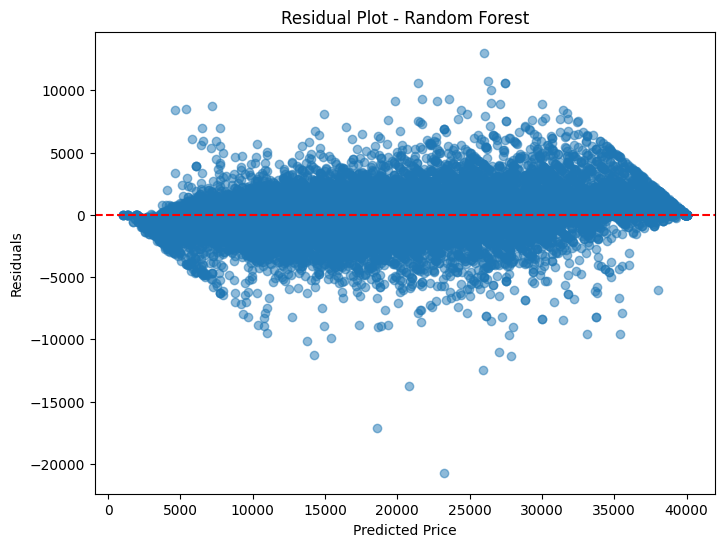

In [ ]:
from sklearn.metrics import mean_squared_error
import numpy as np

top_model = random_forest  # example
y_pred = top_model.predict(train)
residuals = target - y_pred

plt.figure(figsize=(8,6))
plt.scatter(y_pred, residuals, alpha=0.5)
plt.axhline(0, color='red', linestyle='--')
plt.xlabel('Predicted Price')
plt.ylabel('Residuals')
plt.title('Residual Plot - Random Forest')
plt.show()

 Residual plots for top models

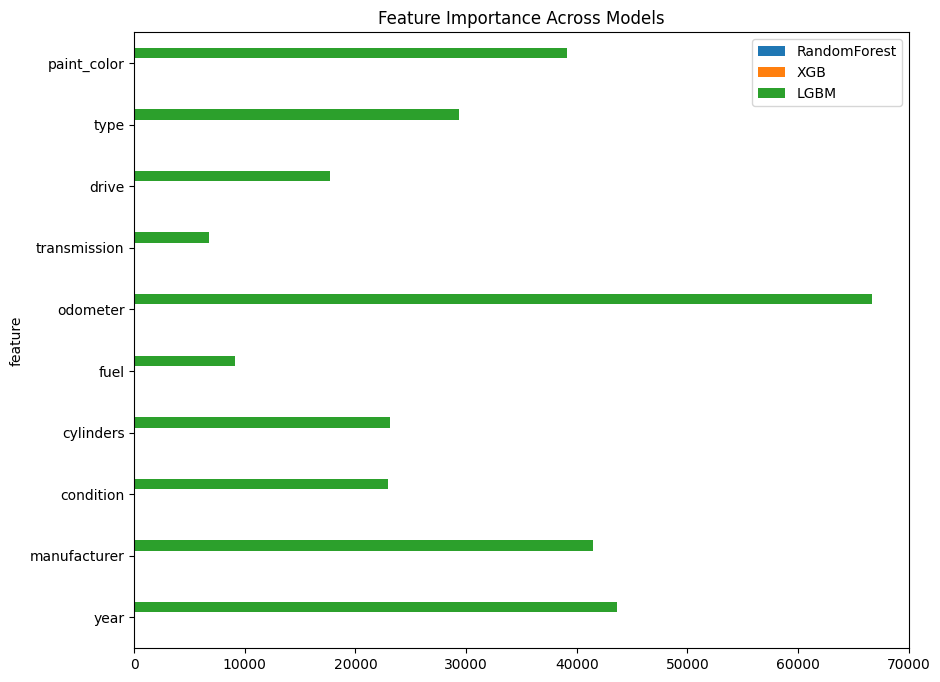

In [ ]:
importances = pd.DataFrame({
    'feature': trainb.columns,
    'RandomForest': random_forest.feature_importances_,
    'XGB': xgb_reg.best_estimator_.feature_importances_,
    'LGBM': modelL.feature_importance()
}).set_index('feature')

importances.plot(kind='barh', figsize=(10,8))
plt.title('Feature Importance Across Models')
plt.show()

Top-N feature importance comparison

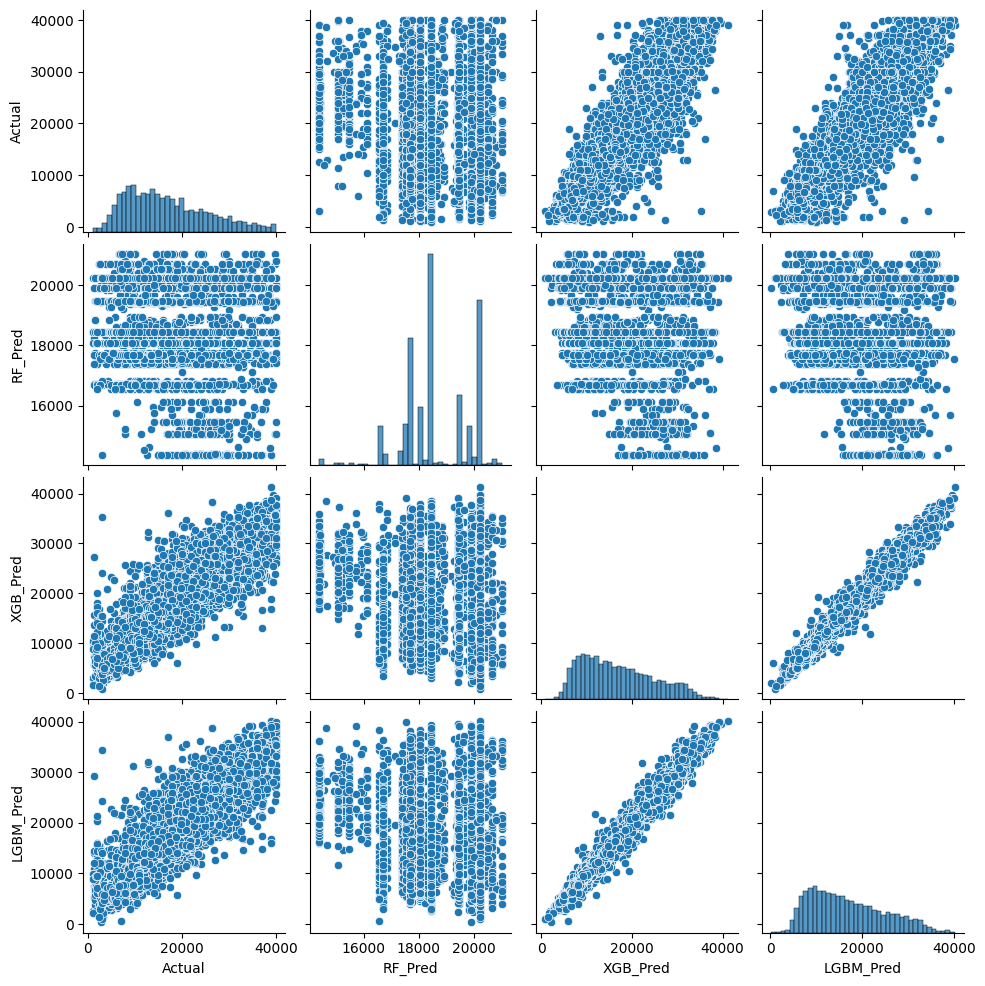

In [ ]:
preds = pd.DataFrame({
    'Actual': target_testb,
    'RF_Pred': random_forest.predict(testb),
    'XGB_Pred': xgb_reg.predict(testb),
    'LGBM_Pred': modelL.predict(testb)
})

sns.pairplot(preds)
plt.show()

Pairplot of actual vs predicted


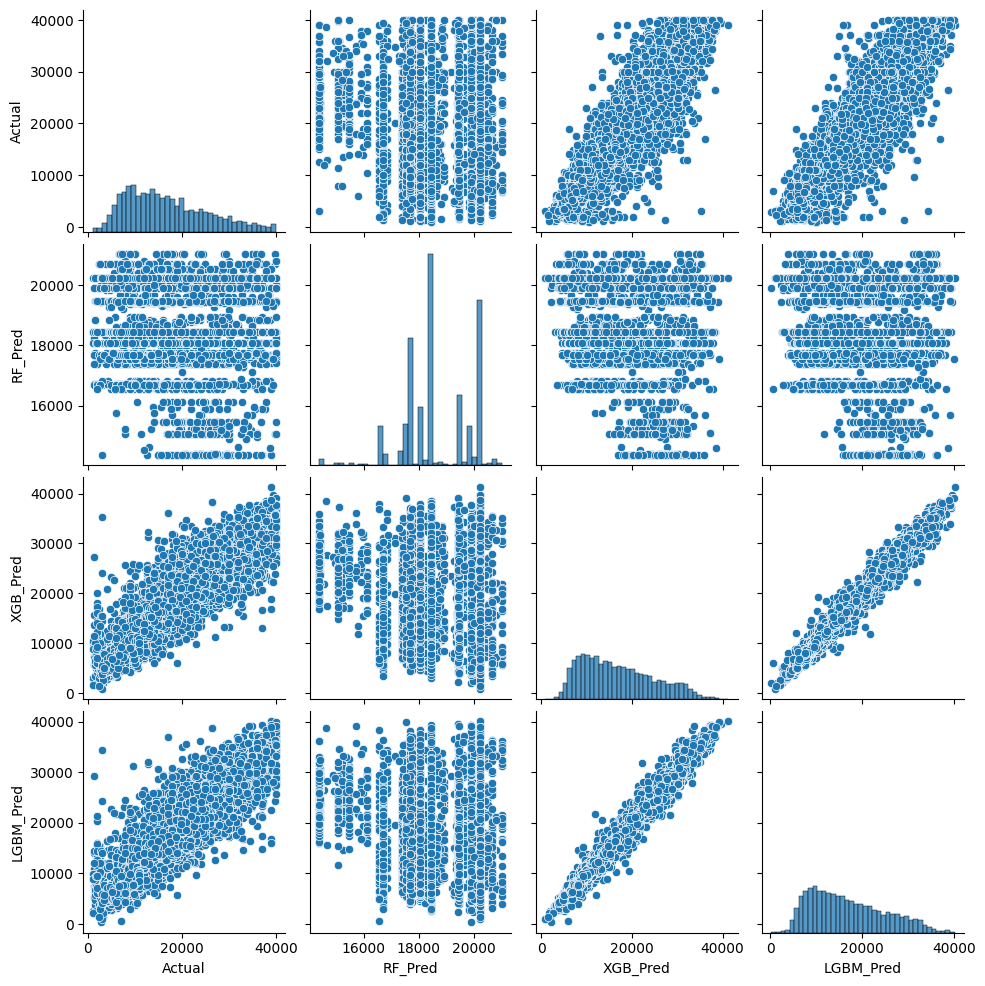

In [ ]:
preds = pd.DataFrame({
    'Actual': target_testb,
    'RF_Pred': random_forest.predict(testb),
    'XGB_Pred': xgb_reg.predict(testb),
    'LGBM_Pred': modelL.predict(testb)
})

sns.pairplot(preds)
plt.show()

In [44]:
train= train0

In [45]:
drop_columns = ['url', 'city', 'city_url', 'make', 'title_status', 'VIN', 'size', 'image_url', 'desc', 'lat','long']
train = train.drop(columns = drop_columns)

In [78]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

scaler.fit(train0)

testn = pd.DataFrame(scaler.transform(test0), columns=test0.columns)              #transforming test set

linear regresssion over transformed set

In [103]:
from sklearn.linear_model import LinearRegression

# Create and fit model on the SAME preprocessing as test set
model = LinearRegression()
model.fit(train0, train_target0)  # train0 and test0 should have same scaling/encoding

# Predict
preds = model.predict(testn)[:3]
print(preds)

[521922.30510186 492190.07424817 541539.48237851]


In [96]:
target = train['price']     #setting target to train price i.e. y column, then deleting train['price'] column


Ridge regresssion over transformed set

In [86]:
target=train['price']

In [79]:
ridge=RidgeCV()
ridge.fit(train0, train_target0)
ridge.predict(testn)[:3]

array([521665.2421386 , 491939.68159465, 541279.03510853])

installing sweetviz

In [387]:
%%capture
!pip install sweetviz

In [447]:
import sweetviz
train.head()

,price,year,manufacturer,condition,cylinders,fuel,odometer,transmission,drive,type,paint_color
0,1500,"2,006.00",cadillac,good,6 cylinders,gas,"236,000.00",automatic,rwd,coupe,blue
1,8900,"2,009.00",lincoln,NaN,NaN,gas,"119,000.00",automatic,NaN,NaN,NaN
2,7995,"2,010.00",cadillac,NaN,NaN,gas,"129,105.00",automatic,NaN,NaN,NaN
3,6995,"2,007.00",NaN,NaN,NaN,gas,"164,296.00",automatic,NaN,NaN,NaN
4,20990,"2,010.00",ram,excellent,6 cylinders,diesel,"123,213.00",automatic,4wd,NaN,white


Profiling report again

In [80]:
train_with_target = pd.concat([train0.reset_index(drop=True), train_target0.reset_index(drop=True)], axis=1)
train_with_target = train_with_target[~train_with_target.isin([np.inf, -np.inf]).any(axis=1)]
train_with_target = train_with_target.dropna()


In [ ]:
report = pp.ProfileReport(train_with_target, title="Profiling Report")
report.to_file("profiling_report.html")

In [ ]:

with open("profiling_report.html", "r") as f:
    html_content = f.read()

from IPython.display import display, HTML
display(HTML(html_content))

In [81]:
numerics = ['int8', 'int16', 'int32', 'int64', 'float16', 'float32', 'float64']
categorical_columns = []
features = train.columns.values.tolist()
for col in features:
    if train[col].dtype in numerics: continue
    categorical_columns.append(col)           # Encoding categorical features

for col in categorical_columns:
    if col in train.columns:
        le = LabelEncoder()
        le.fit(list(train[col].astype(str).values))
        train[col] = le.transform(list(train[col].astype(str).values))

In [88]:
def reduce_mem_usage(df, verbose=True):
    numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
    start_mem = df.memory_usage().sum() / 1024**2
    for col in df.columns:
        col_type = df[col].dtypes
        if col_type in numerics:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:   #used memory usage reduction for large dataset, it was hanging like crazy
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)
    end_mem = df.memory_usage().sum() / 1024**2
    if verbose: print('Mem. usage decreased to {:5.2f} Mb ({:.1f}% reduction)'.format(end_mem, 100 * (start_mem - end_mem) / start_mem))
    return df

In [83]:
train = reduce_mem_usage(train)       #reduced memory usage

Mem. usage decreased to 11.03 Mb (75.0% reduction)


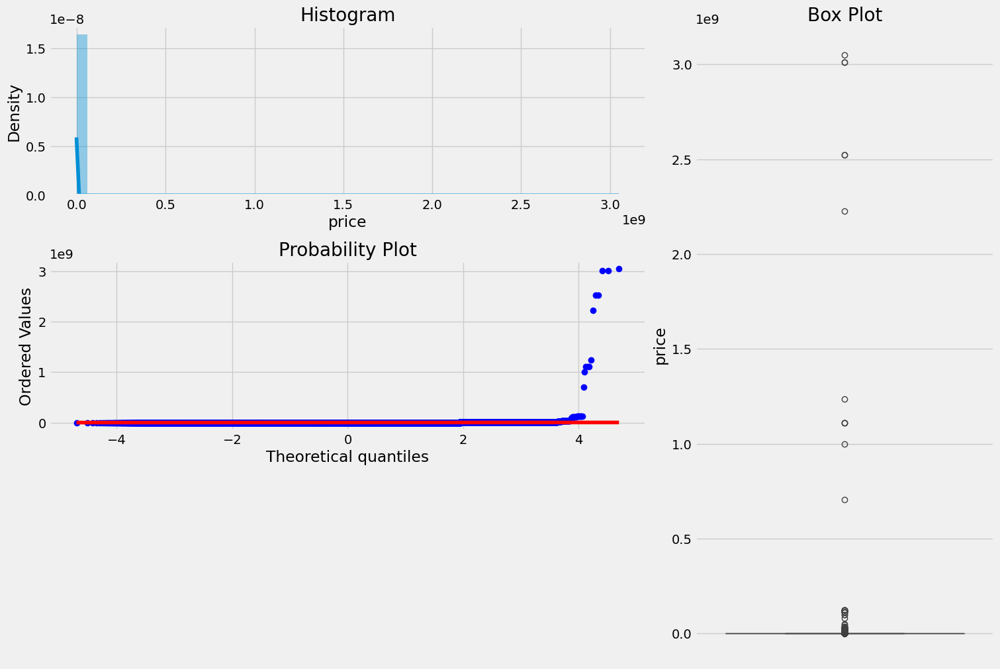

In [91]:
import seaborn as sns
import scipy.stats as stats
from matplotlib import style
import matplotlib.gridspec as gridspec
def plotting_3_chart(df, feature):
    ## Importing seaborn, matplotlab and scipy modules.
    style.use('fivethirtyeight')

    ## Creating a customized chart. and giving in figsize and everything.
    fig = plt.figure(constrained_layout=True, figsize=(15,10))
    ## creating a grid of 3 cols and 3 rows.
    grid = gridspec.GridSpec(ncols=3, nrows=3, figure=fig)

    ## Customizing the histogram grid.
    ax1 = fig.add_subplot(grid[0, :2])
    ## Set the title.
    ax1.set_title('Histogram')
    ## plot the histogram.
    sns.distplot(df.loc[:,feature], norm_hist=True, ax = ax1)

    # customizing the QQ_plot.
    ax2 = fig.add_subplot(grid[1, :2])
    ## Set the title.
    ax2.set_title('QQ_plot')
    ## Plotting the QQ_Plot.
    stats.probplot(df.loc[:,feature], plot = ax2)

    ## Customizing the Box Plot.
    ax3 = fig.add_subplot(grid[:, 2])
    ## Set title.
    ax3.set_title('Box Plot')
    ## Plotting the box plot.
    sns.boxplot(df.loc[:,feature], orient='v', ax = ax3 );

plotting_3_chart(train_new, 'price')

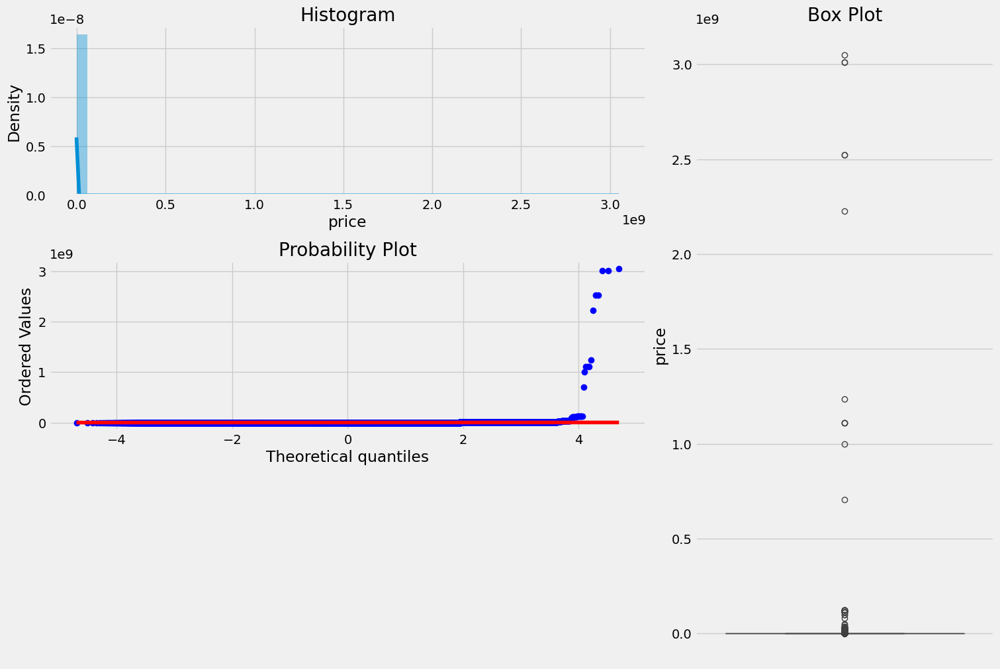

In [92]:
# Rebuild a dataframe that has both features and price for plotting
train_new = pd.DataFrame(train, columns=train0.columns)  # scaled features with column names
train_new['price'] = target.values  # target from the same split

# Now plot
plotting_3_chart(train_new, 'price')

price odomoter year plot

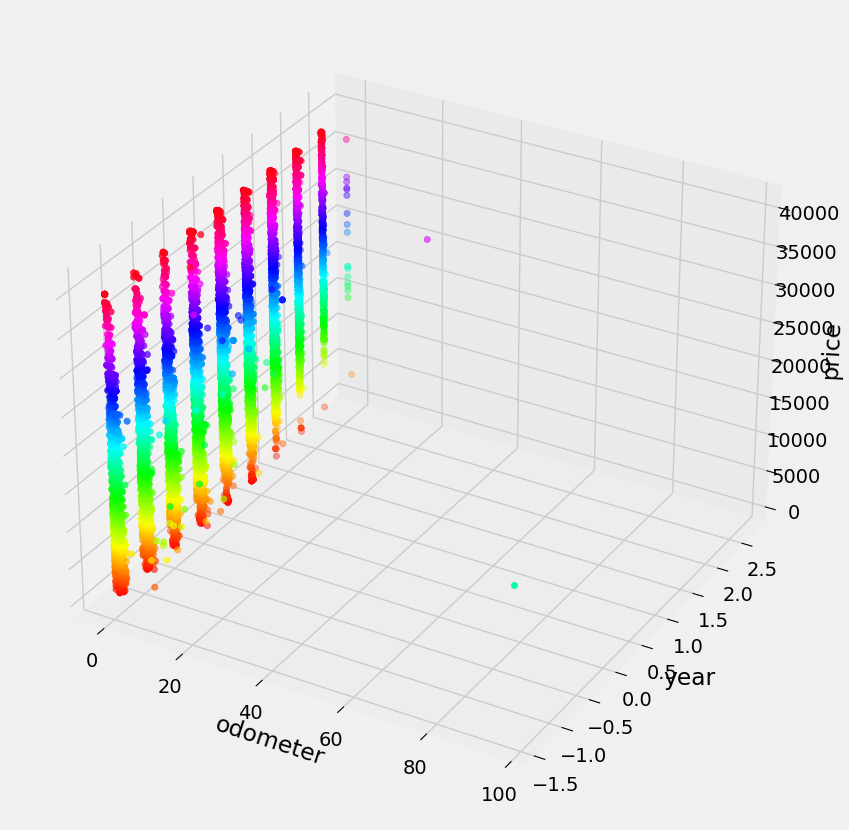

In [ ]:
fig = plt.figure(figsize=(10,10))
ax = plt.axes(projection="3d")

z_points = train_new['price']
x_points = train_new['odometer']
y_points = train_new['year']
ax.scatter3D(x_points, y_points, z_points, c=z_points, cmap='hsv');

ax.set_xlabel('odometer')
ax.set_ylabel('year')
ax.set_zlabel('price')

plt.show()

price index plot


<Axes: ylabel='price'>

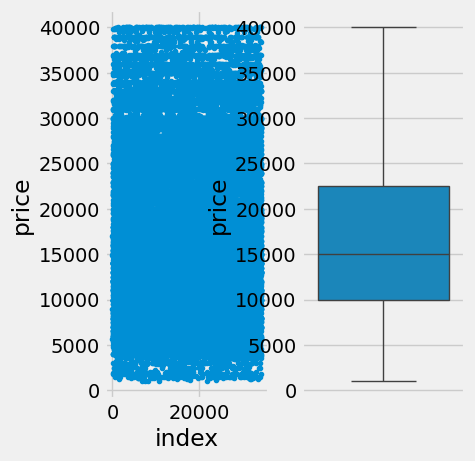

In [ ]:
y = np.array(train_new.price)
plt.subplot(131)
plt.plot(range(len(y)),y,'.');plt.ylabel('price');plt.xlabel('index');
plt.subplot(132)
sns.boxplot(y=train_new.price)

returned 5, 10,90 and 95 percentile value

In [427]:
train_stat = train.describe(percentiles = [.05,.1, .9,.95])
train_stat

,price,year,odometer
count,"525,839.00","524,399.00","427,248.00"
mean,"61,966.05",NaN,"101,150.26"
std,"9,949,703.96",0.00,"105,512.93"
min,0.00,"1,900.00",0.00
5%,0.00,"1,997.00","11,900.00"
10%,100.00,"2,002.00","23,520.40"
50%,"8,999.00","2,011.00","94,240.00"
90%,"27,985.00","2,017.00","179,000.00"
95%,"34,792.20","2,018.00","205,000.00"
max,"3,048,344,231.00","2,020.00","10,000,000.00"


In [428]:
train_stat.loc['max',:]-train_stat.loc['95%',:]

,0
price,"3,048,309,438.80"
year,2.00
odometer,"9,795,000.00"


In [411]:
train_stat.loc['95%',:]-train_stat.loc['90%',:]

,0
year,0.45
manufacturer,0.00
condition,0.00
cylinders,0.00
fuel,0.00
odometer,0.10
transmission,2.35
drive,0.00
type,0.24
paint_color,0.00


In [ ]:
(train_stat.loc['max',:]-train_stat.loc['95%',:])/(train_stat.loc['95%',:]-train_stat.loc['90%',:])

,0
year,2.00
manufacturer,inf
condition,inf
cylinders,inf
fuel,inf
odometer,473.83
transmission,1.00
drive,NaN
type,1.00
paint_color,inf


In [ ]:
train_stat.loc['10%',:]-train_stat.loc['5%',:]

,0
year,0.00
manufacturer,0.19
condition,0.00
cylinders,0.00
fuel,3.94
odometer,0.10
transmission,0.00
drive,0.00
type,0.00
paint_color,0.00


In [ ]:
train_stat.loc['5%',:]-train_stat.loc['min',:]

,0
year,0.00
manufacturer,0.46
condition,0.00
cylinders,2.35
fuel,0.00
odometer,0.10
transmission,0.00
drive,0.00
type,0.00
paint_color,0.00


In [ ]:
(train_stat.loc['5%',:]-train_stat.loc['min',:])/(train_stat.loc['10%',:]-train_stat.loc['5%',:])

,0
year,NaN
manufacturer,2.49
condition,NaN
cylinders,inf
fuel,0.00
odometer,1.00
transmission,NaN
drive,NaN
type,NaN
paint_color,NaN


In [398]:
train_stat.loc[['10%','90%','95%'],:]

,year,manufacturer,condition,cylinders,fuel,odometer,transmission,drive,type,paint_color
10%,-1.41,-1.04,-0.85,-1.14,0.17,-0.62,-0.28,-0.95,-1.48,-1.38
90%,1.32,1.74,1.60,1.21,0.17,0.60,-0.28,1.81,0.91,1.08
95%,1.77,1.74,1.60,1.21,0.17,0.80,2.07,1.81,1.15,1.08


In [93]:
def abnormal_filter(df, threshold_first, threshold_second):       # Abnormal values filter for DataFrame df:


    df_describe = df.describe([.05, .1, .9, .95])         # threshold_second (second diff., times)
    cols = df_describe.columns.tolist()
    i = 0
    abnorm = 0
    for col in cols:
        i += 1
        # abnormal smallest
        P10_5 = df_describe.loc['10%',col]-df_describe.loc['5%',col]
        P_max_min = df_describe.loc['max',col]-df_describe.loc['min',col]
        if P10_5 != 0:
            if (df_describe.loc['5%',col]-df_describe.loc['min',col])/P10_5 > threshold_second:
                #abnormal smallest filter
                df = df[(df[col] >= df_describe.loc['5%',col])]
                print('1: ', i, col, df_describe.loc['min',col],df_describe.loc['5%',col],df_describe.loc['10%',col])
                abnorm += 1
        else:
            if P_max_min > 0:
                if (df_describe.loc['5%',col]-df_describe.loc['min',col])/P_max_min > threshold_first:
                    # abnormal smallest filter
                    df = df[(df[col] >= df_describe.loc['5%',col])]
                    print('2: ', i, col, df_describe.loc['min',col],df_describe.loc['5%',col],df_describe.loc['max',col])
                    abnorm += 1


        # abnormal biggest
        P95_90 = df_describe.loc['95%',col]-df_describe.loc['90%',col]
        if P95_90 != 0:
            if (df_describe.loc['max',col]-df_describe.loc['95%',col])/P95_90 > threshold_second:
                #abnormal biggest filter
                df = df[(df[col] <= df_describe.loc['95%',col])]
                print('3: ', i, col, df_describe.loc['90%',col],df_describe.loc['95%',col],df_describe.loc['max',col])
                abnorm += 1
        else:
            if P_max_min > 0:
                if ((df_describe.loc['max',col]-df_describe.loc['95%',col])/P_max_min > threshold_first) & (df_describe.loc['95%',col] > 0):
                    # abnormal biggest filter
                    df = df[(df[col] <= df_describe.loc['95%',col])]
                    print('4: ', i, col, df_describe.loc['min',col],df_describe.loc['95%',col],df_describe.loc['max',col])
                    abnorm += 1
    print('Number of abnormal values =', abnorm)
    return df

In [94]:
train = abnormal_filter(train, 0.5, 3)
train.info()

3:  1 price 27985.0 34792.19999999995 3048344231.0
1:  2 year 1900.0 1997.0 2002.0
4:  6 fuel 0.0 2.0 5.0
3:  7 odometer 179000.0 205000.0 10000000.0
4:  8 transmission 0.0 1.0 3.0
Number of abnormal values = 5
<class 'pandas.core.frame.DataFrame'>
Index: 339883 entries, 1 to 525838
Data columns (total 11 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   price         339883 non-null  int64  
 1   year          339883 non-null  float16
 2   manufacturer  339883 non-null  int8   
 3   condition     339883 non-null  int8   
 4   cylinders     339883 non-null  int8   
 5   fuel          339883 non-null  int8   
 6   odometer      339883 non-null  float32
 7   transmission  339883 non-null  int8   
 8   drive         339883 non-null  int8   
 9   type          339883 non-null  int8   
 10  paint_color   339883 non-null  int8   
dtypes: float16(1), float32(1), int64(1), int8(8)
memory usage: 9.7 MB


In [95]:
train = train[train['price'] >= 1700]
train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 297285 entries, 1 to 525838
Data columns (total 11 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   price         297285 non-null  int64  
 1   year          297285 non-null  float16
 2   manufacturer  297285 non-null  int8   
 3   condition     297285 non-null  int8   
 4   cylinders     297285 non-null  int8   
 5   fuel          297285 non-null  int8   
 6   odometer      297285 non-null  float32
 7   transmission  297285 non-null  int8   
 8   drive         297285 non-null  int8   
 9   type          297285 non-null  int8   
 10  paint_color   297285 non-null  int8   
dtypes: float16(1), float32(1), int64(1), int8(8)
memory usage: 8.5 MB


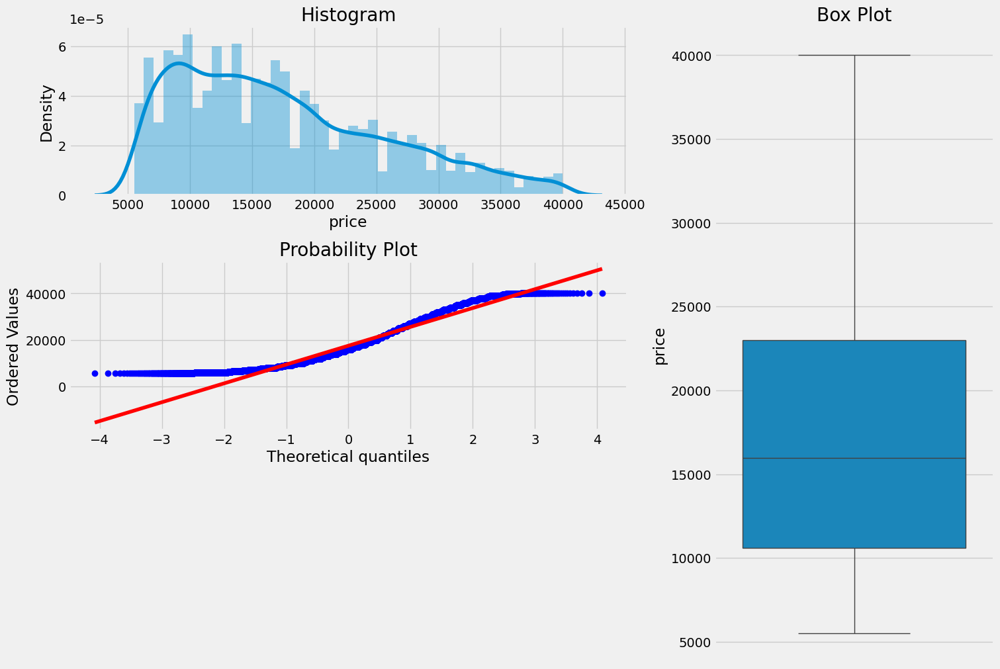

In [ ]:
plotting_3_chart(train, 'price')    #plottice price chart

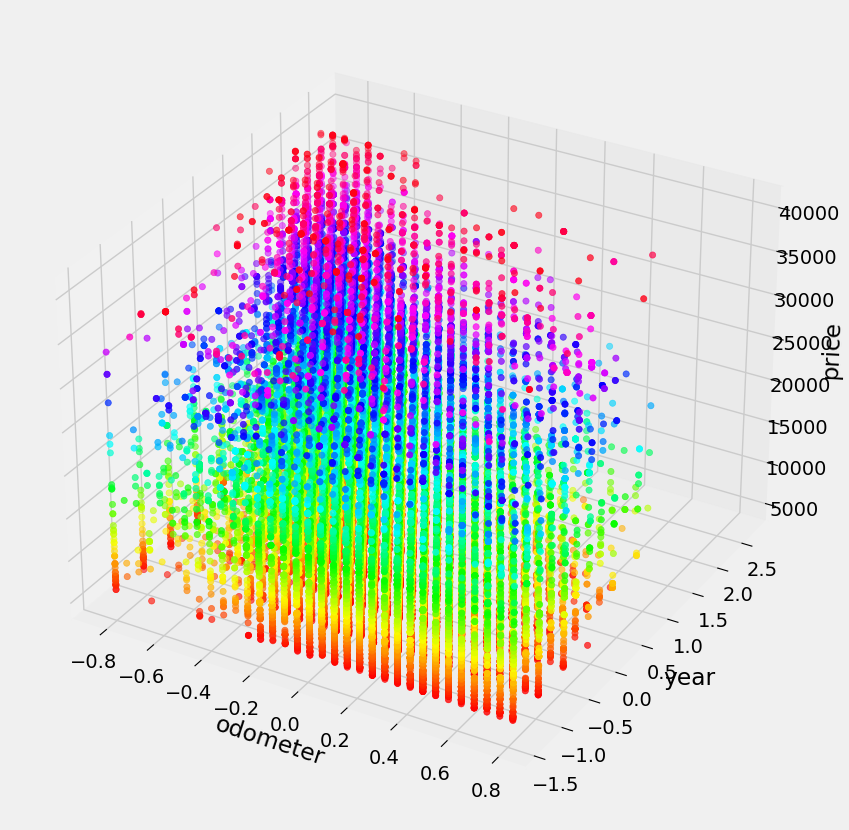

In [ ]:
fig = plt.figure(figsize=(10,10))
ax = plt.axes(projection="3d")

z_points = train['price']
x_points = train['odometer']      #odoometer price and year graph
y_points = train['year']
ax.scatter3D(x_points, y_points, z_points, c=z_points, cmap='hsv');

ax.set_xlabel('odometer')
ax.set_ylabel('year')
ax.set_zlabel('price')

plt.show()

In [ ]:
train.columns

In [97]:
X = train
z = target

In [98]:
Xtrain, Xval, Ztrain, Zval = train_test_split(X, z, test_size=0.2, random_state=0)
train_set = lgbm.Dataset(Xtrain, Ztrain)           #train and validation set
valid_set = lgbm.Dataset(Xval, Zval)

In [99]:
params = {
        'boosting_type':'gbdt',
        'objective': 'regression',
        'num_leaves': 31,
        'learning_rate': 0.05,
        'max_depth': -1,
        'subsample': 0.8,
        'bagging_fraction' : 1,
        'max_bin' : 5000 ,
        'bagging_freq': 20,
        'colsample_bytree': 0.6,
        'metric': 'rmse',
        'min_split_gain': 0.5,
        'min_child_weight': 1,
        'min_child_samples': 10,
        'scale_pos_weight':1,
        'zero_as_missing': True,
        'seed':0,
    }
from lightgbm import early_stopping, log_evaluation

modelL = lgbm.train(                                #lgbm model
    params,
    train_set=train_set,
    num_boost_round=1000,
    valid_sets=[valid_set],
    callbacks=[
        early_stopping(stopping_rounds=50),
        log_evaluation(period=10)
    ]
)

[LightGBM] [Warning] bagging_fraction is set=1, subsample=0.8 will be ignored. Current value: bagging_fraction=1
[LightGBM] [Warning] bagging_fraction is set=1, subsample=0.8 will be ignored. Current value: bagging_fraction=1
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010168 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 9582
[LightGBM] [Info] Number of data points in the train set: 237828, number of used features: 11
[LightGBM] [Warning] bagging_fraction is set=1, subsample=0.8 will be ignored. Current value: bagging_fraction=1
[LightGBM] [Info] Start training from score 13170.728190
Training until validation scores don't improve for 50 rounds
[10]	valid_0's rmse: 5077.2
[20]	valid_0's rmse: 3298.96
[30]	valid_0's rmse: 2180.87
[40]	valid_0's rmse: 1493.7
[50]	valid_0's rmse: 1102.84
[60]	valid_0's rmse: 860.967
[70]	valid_0's rm

In [ ]:
r2_score(Zval, modelL.predict(Xval))      #r2 of zval and model l

0.8150607218115888

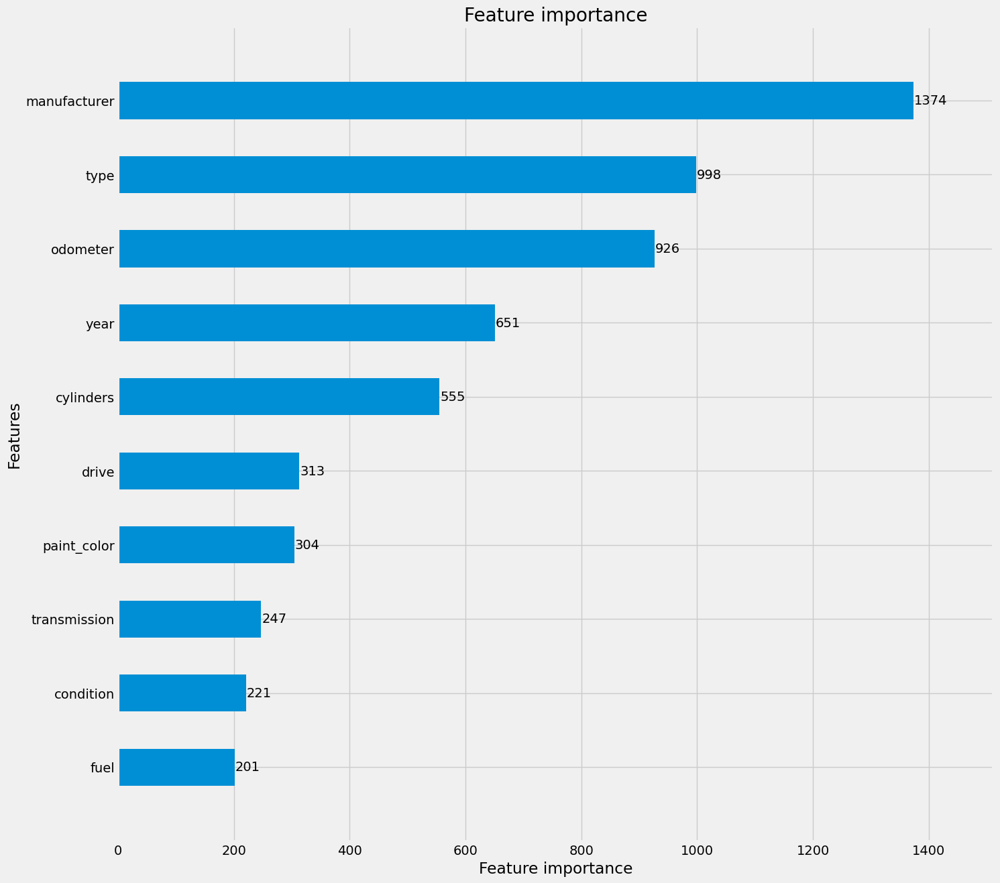

In [ ]:
fig =  plt.figure(figsize = (15,15))
axes = fig.add_subplot(111)
lgbm.plot_importance(modelL,ax = axes,height = 0.5)         #lgbm plot
plt.show();plt.close()

In [ ]:
feature_score = pd.DataFrame(train.columns, columns = ['feature'])
feature_score['score_lgb'] = modelL.feature_importance()

In [ ]:

data_tr  = xgb.DMatrix(Xtrain, label=Ztrain)
data_cv  = xgb.DMatrix(Xval   , label=Zval) #splitted training set to validation set
evallist = [(data_tr, 'train'), (data_cv, 'valid')]

In [ ]:
parms = {'max_depth':8, #maximum depth of a tree
         'objective':'reg:squarederror',
         'eta'      :0.3,
         'subsample':0.8,#SGD will use this percentage of data
         'lambda':4, #L2 regularization term,>1 more conservative
         'colsample_bytree':0.9,
         'colsample_bylevel':1,
         'min_child_weight': 10}
modelx = xgb.train(parms, data_tr, num_boost_round=200, evals = evallist,
                  early_stopping_rounds=30, maximize=False,
                  verbose_eval=10)

print('score = %1.5f, n_boost_round =%d.'%(modelx.best_score,modelx.best_iteration))

[0]	train-rmse:6613.27746	valid-rmse:6617.43739
[10]	train-rmse:3402.32475	valid-rmse:3592.75674
[20]	train-rmse:3172.31320	valid-rmse:3445.34725
[30]	train-rmse:3022.64439	valid-rmse:3372.18598
[40]	train-rmse:2902.44743	valid-rmse:3316.30284
[50]	train-rmse:2815.78335	valid-rmse:3299.61935
[60]	train-rmse:2711.39129	valid-rmse:3274.95887
[70]	train-rmse:2630.95019	valid-rmse:3263.10108
[80]	train-rmse:2564.93954	valid-rmse:3246.19122
[90]	train-rmse:2485.36240	valid-rmse:3233.18305
[100]	train-rmse:2422.61333	valid-rmse:3232.06852
[110]	train-rmse:2368.47653	valid-rmse:3230.58267
[120]	train-rmse:2315.84478	valid-rmse:3228.39112
[130]	train-rmse:2267.58434	valid-rmse:3229.29376
[134]	train-rmse:2246.72756	valid-rmse:3228.38308
score = 3226.31937, n_boost_round =104.


In [ ]:
r2_score(Zval, modelx.predict(data_cv))     #r2 score of model and predict

0.8507692217826843

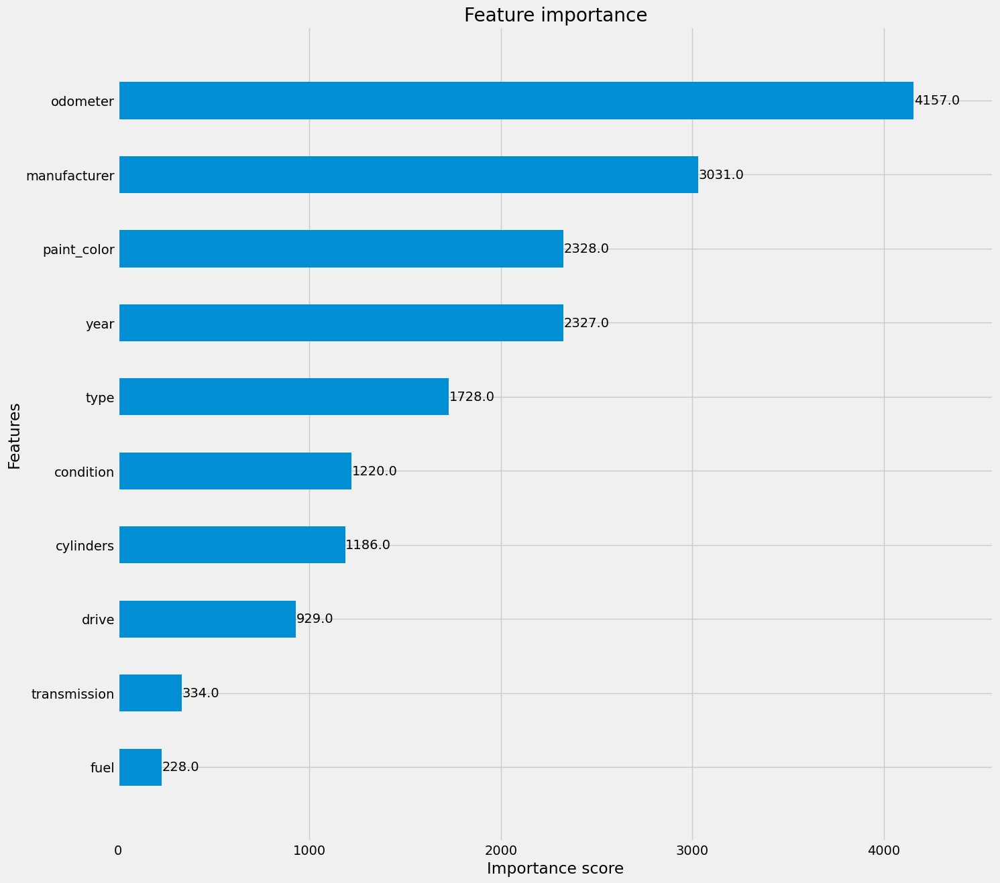

In [ ]:
fig =  plt.figure(figsize = (15,15))
axes = fig.add_subplot(111)         #xgb plot
xgb.plot_importance(modelx,ax = axes,height = 0.5)
plt.show();plt.close()

## Feature score on lbg and xgb plot

In [ ]:
feature_score['score_xgb'] = feature_score['feature'].map(modelx.get_score(importance_type='weight'))
feature_score     #feature scote)

,feature,score_lgb,score_xgb
0,year,651,"2,327.00"
1,manufacturer,1374,"3,031.00"
2,condition,221,"1,220.00"
3,cylinders,555,"1,186.00"
4,fuel,201,228.00
5,odometer,926,"4,157.00"
6,transmission,247,334.00
7,drive,313,929.00
8,type,998,"1,728.00"
9,paint_color,304,"2,328.00"


In [ ]:
from sklearn import preprocessing
train = pd.DataFrame(
    preprocessing.MinMaxScaler().fit_transform(train),
    columns=train.columns,
    index=train.index
)

Linear regression on feature score

In [ ]:
# Linear Regression

linreg = LinearRegression()
linreg.fit(train, target)
coeff_linreg = pd.DataFrame(train.columns.delete(0))
coeff_linreg.columns = ['feature']
coeff_linreg["score_linreg"] = pd.Series(linreg.coef_)
coeff_linreg.sort_values(by='score_linreg', ascending=False)

,feature,score_linreg
3,fuel,"25,696.00"
0,manufacturer,"12,032.00"
6,drive,"1,761.00"
1,condition,170.25
8,paint_color,-9.41
2,cylinders,-111.62
7,type,"-4,444.00"
4,odometer,"-8,432.00"
5,transmission,"-8,648.00"


linear regression on score

In [ ]:
coeff_linreg["score_linreg"] = coeff_linreg["score_linreg"].abs()
feature_score = pd.merge(feature_score, coeff_linreg, on='feature')
feature_score = feature_score.fillna(0)
feature_score = feature_score.set_index('feature')
feature_score

,score_lgb,score_xgb,score_linreg
feature,,,
manufacturer,1374,"3,031.00","12,032.00"
condition,221,"1,220.00",170.25
cylinders,555,"1,186.00",111.62
fuel,201,228.00,"25,696.00"
odometer,926,"4,157.00","8,432.00"
transmission,247,334.00,"8,648.00"
drive,313,929.00,"1,761.00"
type,998,"1,728.00","4,444.00"
paint_color,304,"2,328.00",9.41


# MinMax scale all importances

<Axes: xlabel='feature'>

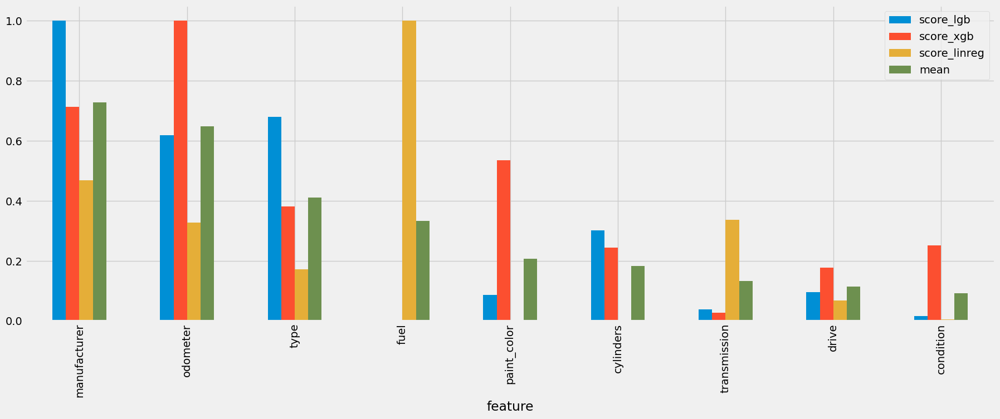

In [ ]:

feature_score = pd.DataFrame(
    preprocessing.MinMaxScaler().fit_transform(feature_score),
    columns=feature_score.columns,
    index=feature_score.index
)

# Create mean column
feature_score['mean'] = feature_score.mean(axis=1)

# Plot the feature importances
feature_score.sort_values('mean', ascending=False).plot(kind='bar', figsize=(20, 7))

In [ ]:
feature_score.sort_values('mean', ascending=False)

,score_lgb,score_xgb,score_linreg,mean
feature,,,,
manufacturer,1.00,0.71,0.47,0.73
odometer,0.62,1.00,0.33,0.65
type,0.68,0.38,0.17,0.41
fuel,0.00,0.00,1.00,0.33
paint_color,0.09,0.53,0.00,0.21
cylinders,0.30,0.24,0.00,0.18
transmission,0.04,0.03,0.34,0.13
drive,0.10,0.18,0.07,0.11
condition,0.02,0.25,0.01,0.09


Feature scores

<Axes: xlabel='feature'>

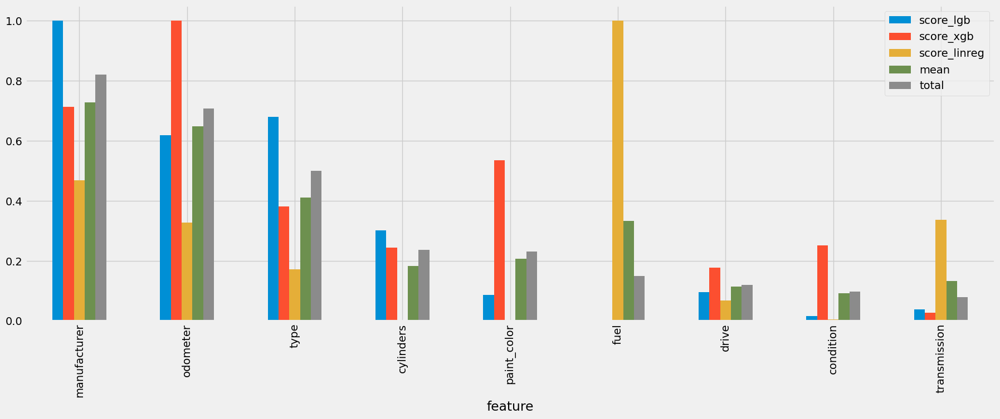

In [ ]:
# Create total column with different weights
feature_score['total'] = 0.5*feature_score['score_lgb'] + 0.35*feature_score['score_xgb'] + 0.15*feature_score['score_linreg']

# Plot the feature importances
feature_score.sort_values('total', ascending=False).plot(kind='bar', figsize=(20, 7))

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def get_feature_importance(model, model_name, X):         #   Return a DataFrame of feature importances for models that support

    try:
        if hasattr(model, "coef_"):
            importance = model.coef_
            if hasattr(importance, "toarray"):  # for sparse matrices
                importance = importance.toarray()[0]
            importance = abs(importance)
        elif hasattr(model, "feature_importances_"):
            importance = model.feature_importances_
        elif hasattr(model, "feature_importance"):  # LightGBM booster
            importance = model.feature_importance()
        else:
            print(f" Model '{model_name}' is wrong")
            return None

        return pd.DataFrame({
            'Feature': X.columns,
            'Importance': importance,
            'Model': model_name
        })

    except Exception as e:
        print(f" model error '{model_name}': {e}")
        return None


all importance score models

In [ ]:
all_importances = []


all_importances.append(get_feature_importance(linreg, "Linear Regression", train))      # Only call on models that support importance
all_importances.append(get_feature_importance(ridge, "Ridge Regressor", train))
all_importances.append(get_feature_importance(decision_tree, "Decision Tree", train))
all_importances.append(get_feature_importance(random_forest, "Random Forest", train))
all_importances.append(get_feature_importance(xgb_reg.best_estimator_, "XGB", train))
all_importances.append(get_feature_importance(modelL, "LGBM", train))
all_importances.append(get_feature_importance(gradient_boosting, "Gradient Boosting", train))
all_importances.append(get_feature_importance(etr, "Extra Trees", train))
all_importances.append(get_feature_importance(Ada_Boost, "AdaBoost", train))


Importance data for model

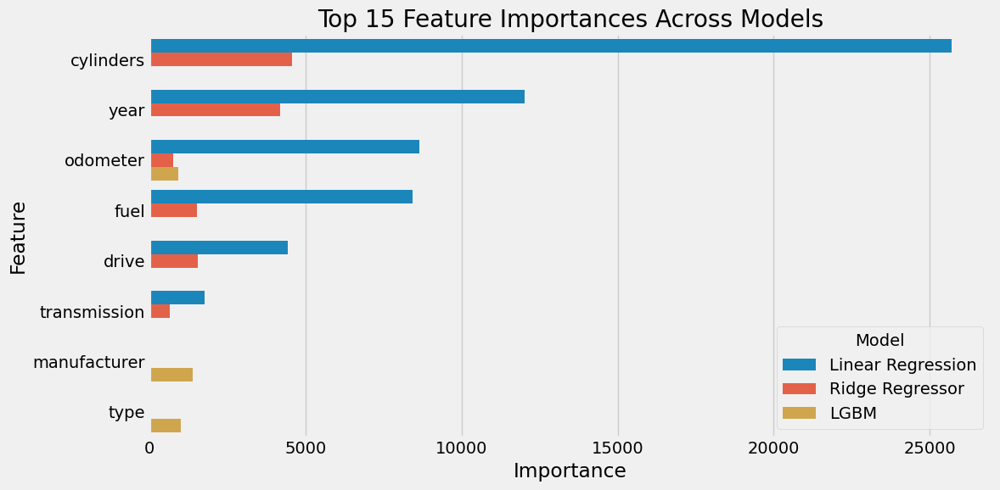

In [ ]:
# Combine all importance data
df_importance = pd.concat([imp for imp in all_importances if imp is not None], ignore_index=True)

# Plot top 15
plt.figure(figsize=(12, 6))
top = df_importance.sort_values("Importance", ascending=False).head(15)
sns.barplot(data=top, x="Importance", y="Feature", hue="Model")
plt.title("Top 15 Feature Importances Across Models")
plt.tight_layout()
plt.show()


In [ ]:
feature_score.sort_values('total', ascending=False)       #feature scoriung

,score_lgb,score_xgb,score_linreg,mean,total
feature,,,,,
manufacturer,1.00,0.71,0.47,0.73,0.82
odometer,0.62,1.00,0.33,0.65,0.71
type,0.68,0.38,0.17,0.41,0.50
cylinders,0.30,0.24,0.00,0.18,0.24
paint_color,0.09,0.53,0.00,0.21,0.23
fuel,0.00,0.00,1.00,0.33,0.15
drive,0.10,0.18,0.07,0.11,0.12
condition,0.02,0.25,0.01,0.09,0.10
transmission,0.04,0.03,0.34,0.13,0.08


Final Pricing Strategy — Based on  Evaluation Table
best model (based on low relative error d_test and strong R²) is: BaggingRegressor
R² test: 85.52
Relative Error (d_test): 11.47%
RMSE (test): ₹3.28 lakh
Close contenders:
VotingRegressor (R² = 86.05, d_test = 12.11%)
Ridge (R² = 84.89, d_test = 12.67%)
XGB (R² = 85.77, d_test = 13.41%)

In [ ]:
final_model = bagging  # This is best performer
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(train0)  #full feature training set (train0)


StandardScaler()

testn = pd.DataFrame(scaler.transform(test0), columns=test0.columns)
predicted_prices = final_model.predict(testn)


In [ ]:
testn = pd.DataFrame(scaler.transform(test0), columns=test0.columns)
predicted_prices = final_model.predict(testn)

test0_with_price = test0.copy()
test0_with_price['Predicted_Price'] = predicted_prices.round(2)


In [ ]:
# Rebuild train_with_price with matching rows
train_with_price = pd.DataFrame(train, columns=train0.columns)
train_with_price['price'] = target.values  # same length and index


In [ ]:
from sklearn.preprocessing import StandardScaler
import pandas as pd
import numpy as np


scaler = StandardScaler()
scaler.fit(train0) #scaler on train0


testn = pd.DataFrame(scaler.transform(test0), columns=test0.columns)

final_model = bagging  # Predict prices using best model  from evaluation
predicted_prices = final_model.predict(testn)

#Creating output DataFrame
test0_with_price = test0.copy()
test0_with_price['Predicted_Price'] = np.round(predicted_prices, 2)


train_w = train0.copy()# Rebuilding train_with_price for reference quantiles
train_with_price['price'] = target.values


def label_price_band(price, reference_df):
    q25 = reference_df['price'].quantile(0.25)
    q75 = reference_df['price'].quantile(0.75)
    if price < q25:# Defining price bands
        return "Undervalued"
    elif price > q75:
        return "Premium"
    else:
        return "Fair"

test0_with_price['Price_Band'] = test0_with_price['Predicted_Price'].apply(
    lambda x: label_price_band(x, train_with_price)
)

test0_with_price['Selling_Price'] = (test0_with_price['Predicted_Price'] * 1.08).round(2)
#Adding business margin (e.g., 8%) to create Selling Price


test0_with_price.to_csv("final_pricing_predictions.csv", index=False)


print(" Final pricing predictions saved to 'final_pricing_predictions.csv'")
display(test0_with_price[['Predicted_Price', 'Price_Band', 'Selling_Price']].head(100))


✅ Final pricing predictions saved to 'final_pricing_predictions.csv'


,Predicted_Price,Price_Band,Selling_Price
4125,"17,666.50",Fair,"19,079.82"
484128,"15,245.65",Fair,"16,465.30"
144345,"17,666.50",Fair,"19,079.82"
247102,"12,527.60",Fair,"13,529.81"
18357,"12,282.10",Fair,"13,264.67"
...,...,...,...
435501,"15,245.65",Fair,"16,465.30"
511956,"15,245.65",Fair,"16,465.30"
213685,"17,666.50",Fair,"19,079.82"
396627,"17,917.00",Fair,"19,350.36"


from matplotlib import pyplot as plt
_df_13['Predicted_Price'].plot(kind='hist', bins=20, title='Predicted_Price')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_14['Selling_Price'].plot(kind='hist', bins=20, title='Selling_Price')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_15.plot(kind='scatter', x='Predicted_Price', y='Selling_Price', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_16['Predicted_Price'].plot(kind='line', figsize=(8, 4), title='Predicted_Price')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_17['Selling_Price'].plot(kind='line', figsize=(8, 4), title='Selling_Price')
plt.gca().spines[['top', 'right']].set_visible(False)



# final prediction pipeline


In [ ]:
print("Final model input features:", list(train0.columns))


Final model input features: ['year', 'manufacturer', 'condition', 'cylinders', 'fuel', 'odometer', 'transmission', 'drive', 'type', 'paint_color']


# Location based heatmap

In [457]:
from wordcloud import WordCloud
import plotly.graph_objects as go
import plotly.express as px
import folium
from folium.plugins import HeatMap


In [451]:
df.sample(5)

,url,city,city_url,price,year,manufacturer,make,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,image_url,desc,lat,long
155161,https://atlanta.craigslist.org/atl/ctd/d/decat...,"atlanta, GA",https://atlanta.craigslist.org,9995,"2,011.00",toyota,sienna,NaN,6 cylinders,gas,"110,453.00",clean,automatic,5TDZK3DC1BS174019,fwd,NaN,other,silver,https://images.craigslist.org/00O0O_JFgcVuBhv2...,This Toyota Sienna can be yours today!If you h...,33.74,-84.26
322530,https://indianapolis.craigslist.org/cto/d/colu...,indianapolis,https://indianapolis.craigslist.org,17350,"2,012.00",jeep,wrangler unlimited sport,excellent,6 cylinders,gas,"94,200.00",lien,automatic,1C4HJWDG9CL103155,4wd,NaN,NaN,white,https://images.craigslist.org/00606_d6ZNRIEr0V...,Jeep Wrangler 4x4 Unlimited Sport SUV is power...,39.23,-85.89
402398,https://odessa.craigslist.org/ctd/d/fort-worth...,odessa / midland,https://odessa.craigslist.org,8090,"2,013.00",volkswagen,tiguan,excellent,NaN,gas,"116,020.00",clean,automatic,WVGAV3AX6DW578458,NaN,NaN,SUV,white,https://images.craigslist.org/00000_6QVS2fa5hR...,2013 *** Volkswagen Tiguan 2WD 4dr Auto SE SUV...,32.76,-97.24
465970,https://seattle.craigslist.org/kit/ctd/d/lynnw...,seattle-tacoma,https://seattle.craigslist.org,31499,"2,017.00",ford,f150 xlt 4x4 1/2 ton gas,NaN,NaN,gas,"29,456.00",clean,automatic,1FTEW1EP3HKD56166,4wd,NaN,truck,grey,https://images.craigslist.org/00K0K_ja7W6h02mh...,2017 Ford F150 XLT 4x4\n**Clean Carfax Two Own...,47.84,-122.30
253996,https://detroit.craigslist.org/wyn/ctd/d/allen...,detroit metro,https://detroit.craigslist.org,18995,"2,017.00",ford,explorer,good,6 cylinders,gas,"31,000.00",rebuilt,automatic,1FM5K7D80HGD78200,fwd,NaN,NaN,NaN,https://images.craigslist.org/00C0C_dXow7e6SdV...,CALL OR VISIT US ONLINE TO SAVE UP TO 50% OFF ...,42.27,-83.23


In [ ]:

df.isnull().sum()

,0
url,0
city,0
city_url,0
price,0
year,1440
manufacturer,24579
make,8638
condition,245958
cylinders,210400
fuel,4295


missing data from dataset

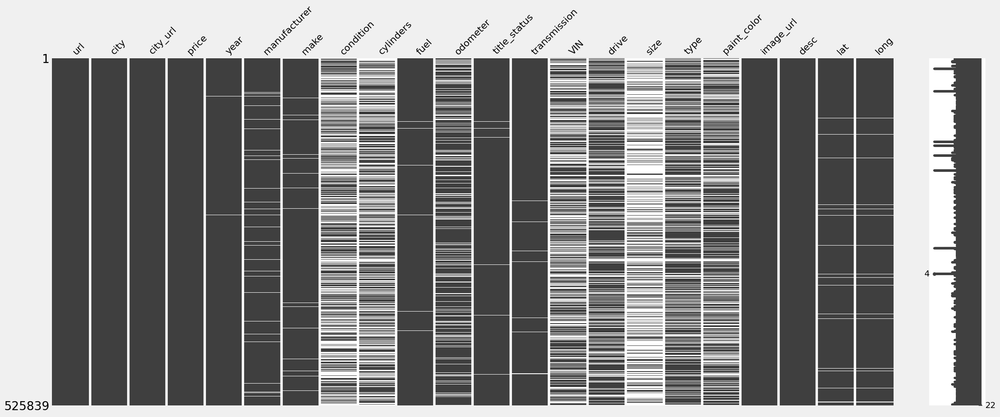

In [ ]:
import missingno as msno
msno.matrix(df)
plt.show()

In [105]:
df.columns

Index(['url', 'city', 'city_url', 'price', 'year', 'manufacturer', 'make',
       'condition', 'cylinders', 'fuel', 'odometer', 'title_status',
       'transmission', 'VIN', 'drive', 'size', 'type', 'paint_color',
       'image_url', 'desc', 'lat', 'long'],
      dtype='object')

In [106]:
df.drop(columns=['url','image_url','VIN'],inplace=True)

odometer vs manufacturer plot

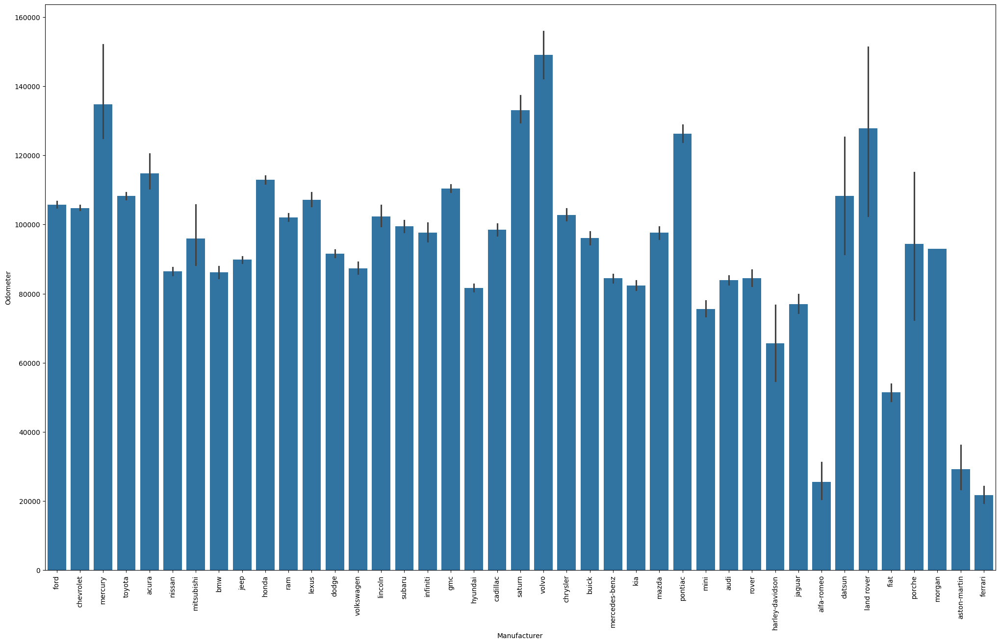

In [455]:
import seaborn as sns
df=df.sort_values(by=['odometer'],ascending=False)
plt.figure(figsize=(25,15))
sns.barplot(x=df.manufacturer, y=df.odometer)
plt.xticks(rotation= 90)
plt.xlabel('Manufacturer')
plt.ylabel('Odometer')
plt.show()

gas label plot

In [458]:
gasLabels = df[df["fuel"]=="gas"].paint_color.value_counts().head(10).index
gasValues = df[df["fuel"]=="gas"].paint_color.value_counts().head(10).values
dieselLabels = df[df["fuel"]=="diesel"].paint_color.value_counts().head(10).index
dieselValues = df[df["fuel"]=="diesel"].paint_color.value_counts().head(10).values
electricLabels = df[df["fuel"]=="electric"].paint_color.value_counts().head(10).index
electricValues = df[df["fuel"]=="electric"].paint_color.value_counts().head(10).values

from plotly.subplots import make_subplots

# Create subplots: use 'domain' type for Pie subplot
fig = make_subplots(rows=1, cols=3, specs=[[{'type':'domain'}, {'type':'domain'}, {'type':'domain'}]])
fig.add_trace(go.Pie(labels=gasLabels, values=gasValues, name="Gas Car"),
              1, 1)
fig.add_trace(go.Pie(labels=dieselLabels, values=dieselValues, name="Diesel Car"),
              1, 2)
fig.add_trace(go.Pie(labels=electricLabels, values=electricValues, name="Electric Car"),
              1, 3)

# Use `hole` to create a donut-like pie chart
fig.update_traces(hole=.4, hoverinfo="label+percent+name")

fig.show()

paint color plot

In [ ]:
x = df.type
y = df.paint_color

fig = go.Figure(go.Histogram2d(
        x=x,
        y=y
    ))
fig.show()

map plot of cars

In [ ]:
fig = px.scatter_mapbox(df[df["type"]=="bus"], lat="lat", lon="long", hover_name="paint_color", hover_data=["paint_color", "price"],
                        color_discrete_sequence=["fuchsia"], zoom=4, height=600)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

heat map of cars listed

In [ ]:
cars=df[df["type"]=="bus"].iloc[:,17:19]
cars.rename(columns={'lat':'latitude','long':'longitude'}, inplace=True)
cars.latitude.fillna(0, inplace = True)
cars.longitude.fillna(0, inplace = True)

CarMap=folium.Map(location=[42.5,-71],zoom_start=4)
HeatMap(data=cars, radius=16).add_to(CarMap)
CarMap.save('index.html')
CarMap

In [107]:
df.columns
mf = df['manufacturer'].value_counts()

In [460]:
df['manufacturer'] = df['manufacturer'].apply(lambda s: s if str(s) in mf[:10] else 'others')

In [108]:
mf = df['manufacturer'].value_counts()

manufacturer vs listings

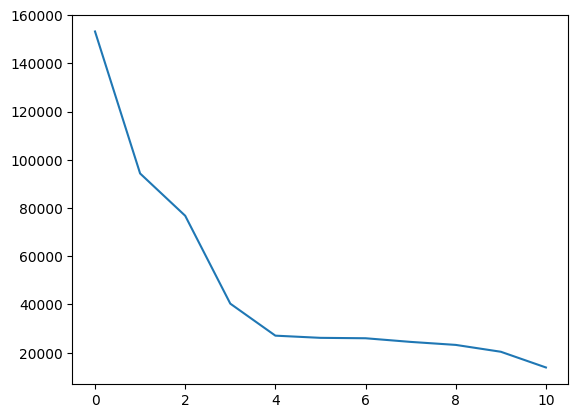

In [462]:
plt.plot(range(len(mf)), mf)

In [463]:
df.columns

Index(['city', 'city_url', 'price', 'year', 'manufacturer', 'make',
       'condition', 'cylinders', 'fuel', 'odometer', 'title_status',
       'transmission', 'drive', 'size', 'type', 'paint_color', 'desc', 'lat',
       'long'],
      dtype='object')

In [109]:
md = df['make'].value_counts()

make vs listings

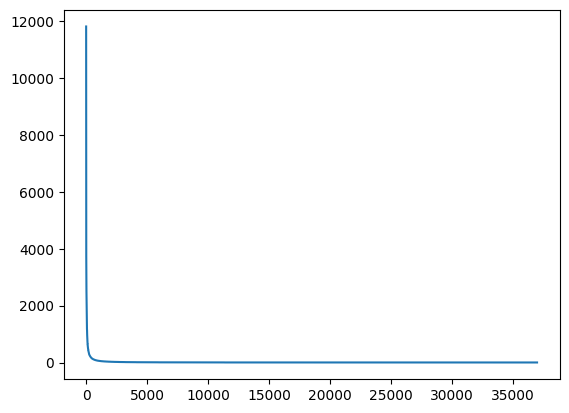

In [465]:
plt.plot(range(len(md)), md)

In [466]:
df['make'] = df['make'].apply(lambda s: s if str(s) in md[:50] else 'others')

various catergories across columns

In [467]:
for i in df.columns:
  print(i, len(df[i].value_counts().index))

city 413
city_url 413
price 18937
year 110
manufacturer 11
make 51
condition 6
cylinders 8
fuel 5
odometer 121686
title_status 6
transmission 3
drive 3
size 4
type 13
paint_color 12
desc 444072
lat 69386
long 69537


In [110]:
p1 = df['price'].quantile(0.99)
p2 = df['price'].quantile(0.1)

99 and 10 percenticle price

In [111]:
print(p1, p2)

50995.0 100.0


In [471]:
df = df[(df['price']<p1) & (df['price']>p2)]

99 and 5 percentile odometer

In [113]:
o1 = df['odometer'].quantile(0.99)
o2 = df['odometer'].quantile(0.05)
print(o1, o2)

274922.0 11900.0


In [114]:
df = df[(df['odometer']<o1) & (df['odometer']>o2)]

latitide vs plot

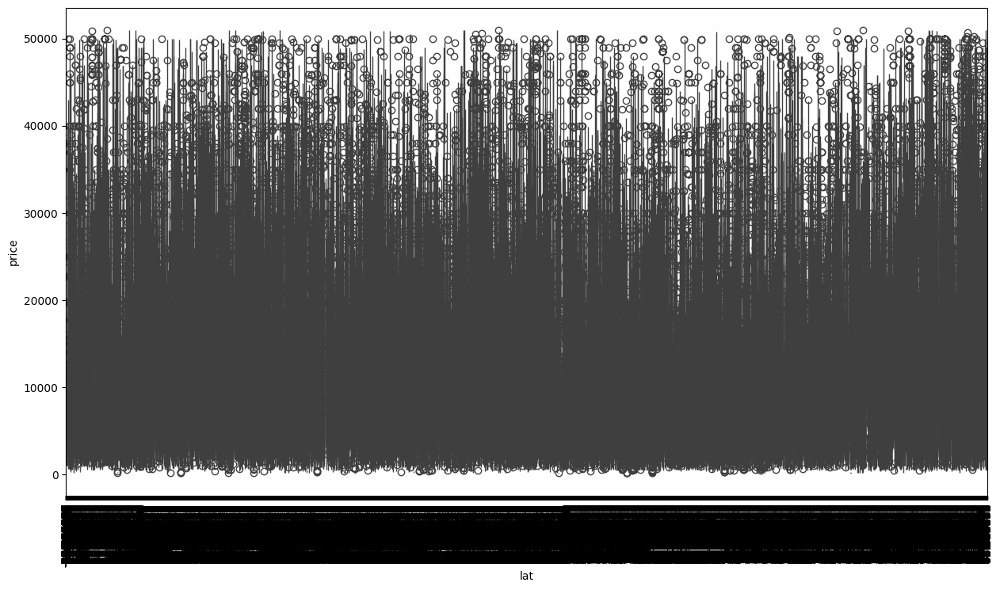

In [474]:
fig = plt.figure(figsize=(15,8))
sns.boxplot(data=df, x='lat', y='price')
plt.xticks(rotation=90)
plt.show()

make vs price

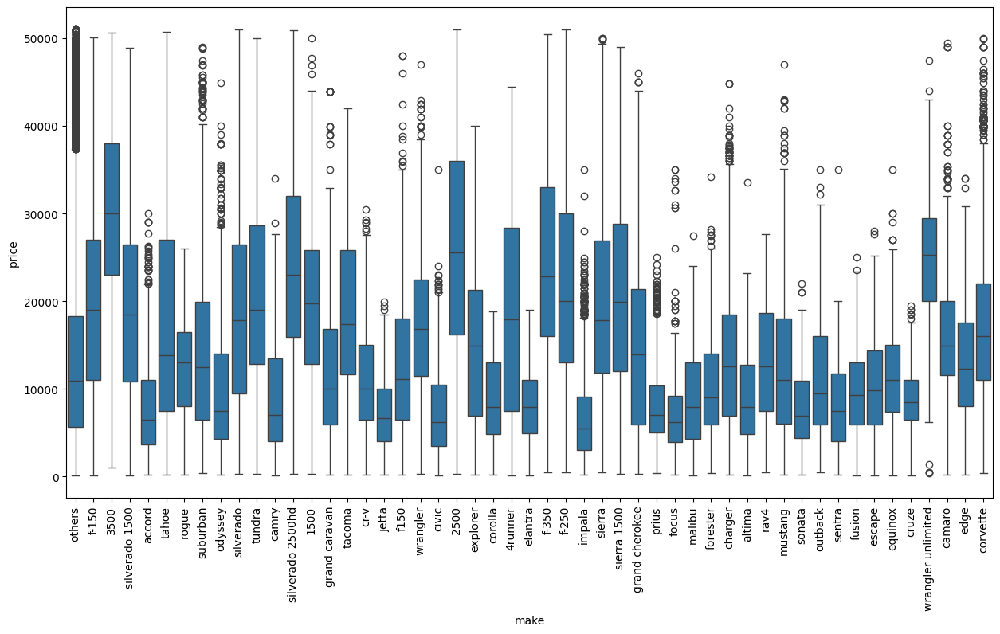

In [475]:
fig = plt.figure(figsize=(15,8))
sns.boxplot(data=df, x='make', y='price')
plt.xticks(rotation=90)
plt.show()

condition vs price

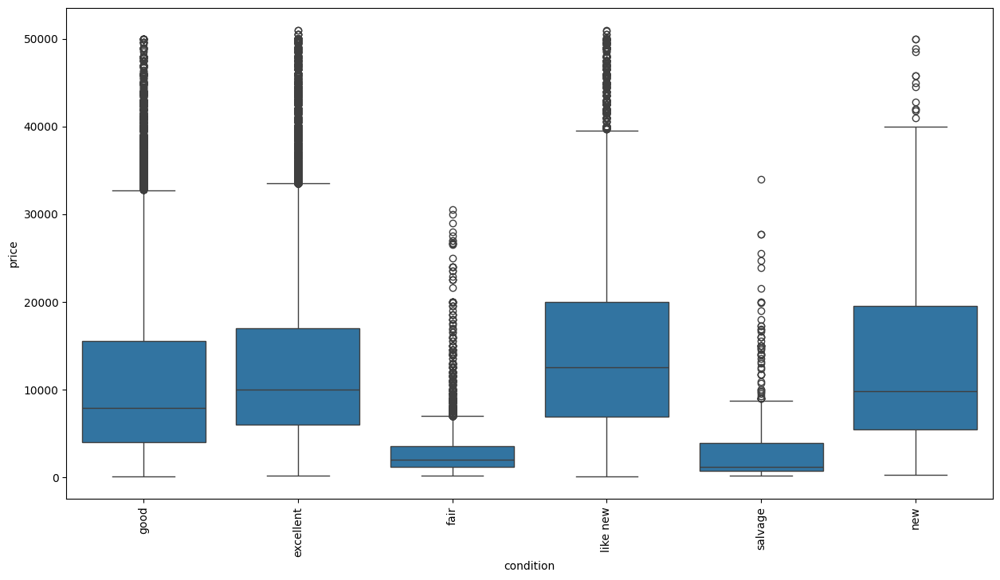

In [476]:
fig = plt.figure(figsize=(15,8))
sns.boxplot(data=df, x='condition', y='price')
plt.xticks(rotation=90)
plt.show()

In [104]:
import folium
from folium import plugins
import numpy as np

m = folium.Map([44 ,68], zoom_start=5,width="100%",height="100%")
locations = list(zip(df.dropna().lat, df.dropna().long))
icons = [folium.Icon(icon="airbnb", prefix="fa") for i in range(len(locations))]

cluster = plugins.MarkerCluster(locations=locations)
m.add_child(cluster)
m

In [115]:
data=df

In [ ]:
sns.pairplot(data[['v.id', 'on road old', 'on road now', 'years', 'km', 'rating', 'condition', 'economy', 'top speed',
'hp', 'torque', 'current price']],diag_kind = 'kde')

## Car price predicrtion

In [117]:
df
df = df.drop(['VIN', 'url', 'image_url'], axis=1) #dropping VIN url and image url

KeyError: "['VIN', 'url', 'image_url'] not found in axis"

In [135]:
# Keeping only the first 20crore rows
df = df.head(9000000)

In [136]:
df.columns

Index(['city', 'city_url', 'price', 'year', 'manufacturer', 'make',
       'condition', 'cylinders', 'fuel', 'odometer', 'title_status',
       'transmission', 'drive', 'size', 'type', 'paint_color', 'desc', 'lat',
       'long'],
      dtype='object')

creating categorical anf numerical trnasformer for the pipeline

In [138]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error



target = "price"
drop_cols = ["city_url", "desc"]
X = df.drop(columns=[target] + drop_cols)
y = df[target]

numeric_features = ['year', 'odometer', 'lat', 'long']
categorical_features = [col for col in X.columns if col not in numeric_features]

numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ]
)

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

creating these 2 lists for predictions

In [133]:
results = []  # store (ModelName, R2, MAE, RMSE)
feature={}

linear regression

In [139]:
from sklearn.linear_model import LinearRegression


results = []       # List to store (model_name, r2, mae, rmse)
fitted_pipes = {}  # Dict to store fitted pipelines

# Define model name
name = "Linear Regression"


model = LinearRegression()# Quick train/test evaluation
pipe = Pipeline(steps=[('preprocessor', preprocessor), ('model', model)])
pipe.fit(X_train, y_train)

y_pred = pipe.predict(X_test)


r2 = r2_score(y_test, y_pred)# Metrics
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))


print(f"{name} → R2: {r2:.4f}, MAE: {mae:.2f}, RMSE: {rmse:.2f}")# Output


results.append((name, r2, mae, rmse))

#fitted pipeline
fitted_pipes[name] = pipe

Linear Regression → R2: 0.3393, MAE: 5488.32, RMSE: 8459.25


In [141]:
feature

{}

using svr

In [142]:
from sklearn.svm import SVR



name = "SVM (RBF Kernel)"
model = SVR(kernel='rbf', C=100, gamma=0.1)

#pipeline
pipe = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', model)
])
pipe.fit(X_train, y_train)

# Predictions
y_pred = pipe.predict(X_test)

# Metrics
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

print(f"{name} → R2: {r2:.4f}, MAE: {mae:.2f}, RMSE: {rmse:.2f}")


results.append((name, r2, mae, rmse))# Saving results & model
fitted_pipes[name] = pipe

SVM (RBF Kernel) → R2: 0.2771, MAE: 6445.87, RMSE: 8848.49


linear svr

In [143]:
from sklearn.svm import LinearSVR


name = "Linear SVR"#
model = LinearSVR(max_iter=10000)  # increased max_iter to ensure convergence

pipe = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', model)
# Build and fit pipeline
])
pipe.fit(X_train, y_train)

# Predictions
y_pred = pipe.predict(X_test)

# Metrics
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

# Output
print(f"{name} → R2: {r2:.4f}, MAE: {mae:.2f}, RMSE: {rmse:.2f}")

# Save results & fitted pipeline
results.append((name, r2, mae, rmse))
fitted_pipes[name] = pipe

Linear SVR → R2: -0.3664, MAE: 8846.89, RMSE: 12165.17


mlp regressor

In [144]:
from sklearn.neural_network import MLPRegressor

# Model name and definition
name = "MLPRegressor"
model = MLPRegressor(hidden_layer_sizes=(64, 32), max_iter=500, random_state=42)
#increased neurons & iterations to allow learning

# Build and fit pipeline
pipe = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', model)
])
pipe.fit(X_train, y_train)

# Predictions
y_pred = pipe.predict(X_test)

# Metrics (calculate once, reuse)
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))


print(f"{name} → R2: {r2:.4f}, MAE: {mae:.2f}, RMSE: {rmse:.2f}")


results.append((name, r2, mae, rmse))
fitted_pipes[name] = pipe

MLPRegressor → R2: 0.5941, MAE: 4353.03, RMSE: 6630.59


sgd regressor

In [145]:
from sklearn.linear_model import SGDRegressor


name = "SGD Regressor"
model = SGDRegressor(max_iter=1000, tol=1e-3, random_state=42)


pipe = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', model)
])
pipe.fit(X_train, y_train)

# Predictions
y_pred = pipe.predict(X_test)

# Metrics (calculate once, reuse)
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))


print(f"{name} → R2: {r2:.4f}, MAE: {mae:.2f}, RMSE: {rmse:.2f}")


results.append((name, r2, mae, rmse))
fitted_pipes[name] = pipe

SGD Regressor → R2: 0.5375, MAE: 4920.11, RMSE: 7077.30


decision tree

In [146]:
from sklearn.tree import DecisionTreeRegressor


name = "Decision Tree"
model = DecisionTreeRegressor(random_state=42)

# Build and fit pipeline
pipe = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', model)
])
pipe.fit(X_train, y_train)

# Predictions
y_pred = pipe.predict(X_test)

# Metrics (calculate once, reuse)
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))


print(f"{name} → R2: {r2:.4f}, MAE: {mae:.2f}, RMSE: {rmse:.2f}")


results.append((name, r2, mae, rmse))
fitted_pipes[name] = pipe

Decision Tree → R2: 0.3724, MAE: 4910.46, RMSE: 8244.31


random forest

In [147]:
from sklearn.ensemble import RandomForestRegressor


name = "Random Forest"
model = RandomForestRegressor(n_estimators=200, random_state=42, n_jobs=-1)


pipe = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', model)
])
pipe.fit(X_train, y_train)

# Predictions
y_pred = pipe.predict(X_test)

# Metrics (calculate once, reuse)
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))


print(f"{name} → R2: {r2:.4f}, MAE: {mae:.2f}, RMSE: {rmse:.2f}")


results.append((name, r2, mae, rmse))
fitted_pipes[name] = pipe

Random Forest → R2: 0.6383, MAE: 3750.56, RMSE: 6259.28


xgboosting

In [148]:
import xgboost as xgb


name = "XGB"
model = xgb.XGBRegressor(n_estimators=300, learning_rate=0.1, random_state=42, n_jobs=-1)


pipe = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', model)
])
pipe.fit(X_train, y_train)


y_pred = pipe.predict(X_test)


r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))


print(f"{name} → R2: {r2:.4f}, MAE: {mae:.2f}, RMSE: {rmse:.2f}")


results.append((name, r2, mae, rmse))
fitted_pipes[name] = pipe

XGB → R2: 0.6219, MAE: 3843.24, RMSE: 6399.36


light gbm

In [149]:
import lightgbm as lgb


name = "LGBM"
model = lgb.LGBMRegressor(n_estimators=300, learning_rate=0.1, random_state=42, n_jobs=-1)

# Build and fit pipeline
pipe = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', model)
])
pipe.fit(X_train, y_train)

# Predictions as earlier
y_pred = pipe.predict(X_test)


r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))


print(f"{name} → R2: {r2:.4f}, MAE: {mae:.2f}, RMSE: {rmse:.2f}")


results.append((name, r2, mae, rmse))
fitted_pipes[name] = pipe

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000371 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 880
[LightGBM] [Info] Number of data points in the train set: 1600, number of used features: 69
[LightGBM] [Info] Start training from score 13210.211875
LGBM → R2: 0.6335, MAE: 3911.48, RMSE: 6300.56


dradient boosting

In [150]:
from sklearn.ensemble import GradientBoostingRegressor

name = "Gradient Boosting"
model = GradientBoostingRegressor(n_estimators=300, random_state=42)


pipe = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', model)
])
pipe.fit(X_train, y_train)


y_pred = pipe.predict(X_test)


r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))


print(f"{name} → R2: {r2:.4f}, MAE: {mae:.2f}, RMSE: {rmse:.2f}")


results.append((name, r2, mae, rmse))
fitted_pipes[name] = pipe

Gradient Boosting → R2: 0.6077, MAE: 4178.06, RMSE: 6518.00


ridge regression

In [151]:
from sklearn.linear_model import Ridge

model = Ridge(alpha=1.0)
pipe = Pipeline(steps=[('preprocessor', preprocessor), ('model', model)])
pipe.fit(X_train, y_train)
y_pred = pipe.predict(X_test)

print("Ridge → R2:", r2_score(y_test, y_pred),
      "MAE:", mean_absolute_error(y_test, y_pred),
      "RMSE:", np.sqrt(mean_squared_error(y_test, y_pred)))
results.append(("Ridge → R2:", r2_score(y_test, y_pred), mean_absolute_error(y_test, y_pred), np.sqrt(mean_squared_error(y_test, y_pred))))

Ridge → R2: 0.5086901383333877 MAE: 4946.342983637288 RMSE: 7294.643497429089


bagging

In [152]:
from sklearn.ensemble import BaggingRegressor


name = "Bagging"
model = BaggingRegressor(n_estimators=200, random_state=42, n_jobs=-1)


pipe = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', model)
])
pipe.fit(X_train, y_train)


y_pred = pipe.predict(X_test)


r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))


print(f"{name} → R2: {r2:.4f}, MAE: {mae:.2f}, RMSE: {rmse:.2f}")


results.append((name, r2, mae, rmse))
fitted_pipes[name] = pipe

Bagging → R2: 0.6401, MAE: 3746.92, RMSE: 6243.53


In [153]:
from sklearn.ensemble import ExtraTreesRegressor


name = "Extra Trees"
model = ExtraTreesRegressor(n_estimators=300, random_state=42, n_jobs=-1)


pipe = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', model)
])
pipe.fit(X_train, y_train)


y_pred = pipe.predict(X_test)

r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))


print(f"{name} → R2: {r2:.4f}, MAE: {mae:.2f}, RMSE: {rmse:.2f}")


results.append((name, r2, mae, rmse))
fitted_pipes[name] = pipe

Extra Trees → R2: 0.6074, MAE: 3898.99, RMSE: 6520.60


adaptive boosting

In [154]:
from sklearn.ensemble import AdaBoostRegressor


name = "AdaBoost"
model = AdaBoostRegressor(n_estimators=300, random_state=42)


pipe = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', model)
])
pipe.fit(X_train, y_train)


y_pred = pipe.predict(X_test)


r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))


print(f"{name} → R2: {r2:.4f}, MAE: {mae:.2f}, RMSE: {rmse:.2f}")


results.append((name, r2, mae, rmse))
fitted_pipes[name] = pipe

AdaBoost → R2: 0.3621, MAE: 6339.82, RMSE: 8311.73


plot of r suqared model performance


=== Model Performance Comparison ===
                Model        R2          MAE          RMSE
12            Bagging  0.640079  3746.921660   6243.528359
7       Random Forest  0.638260  3750.562472   6259.280457
9                LGBM  0.633473  3911.482082   6300.560189
8                 XGB  0.621888  3843.237793   6399.358405
10  Gradient Boosting  0.607738  4178.057771   6518.003146
13        Extra Trees  0.607425  3898.987331   6520.603692
4        MLPRegressor  0.594070  4353.030342   6630.587364
5       SGD Regressor  0.537531  4920.113267   7077.300932
11        Ridge → R2:  0.508690  4946.342984   7294.643497
6       Decision Tree  0.372438  4910.459167   8244.314032
14           AdaBoost  0.362133  6339.817360   8311.732665
0   Linear Regression  0.339289  5488.323176   8459.254373
1    SVM (RBF Kernel)  0.277088  6445.872106   8848.485385
2    SVM (RBF Kernel)  0.277088  6445.872106   8848.485385
3          Linear SVR -0.366418  8846.892848  12165.167615


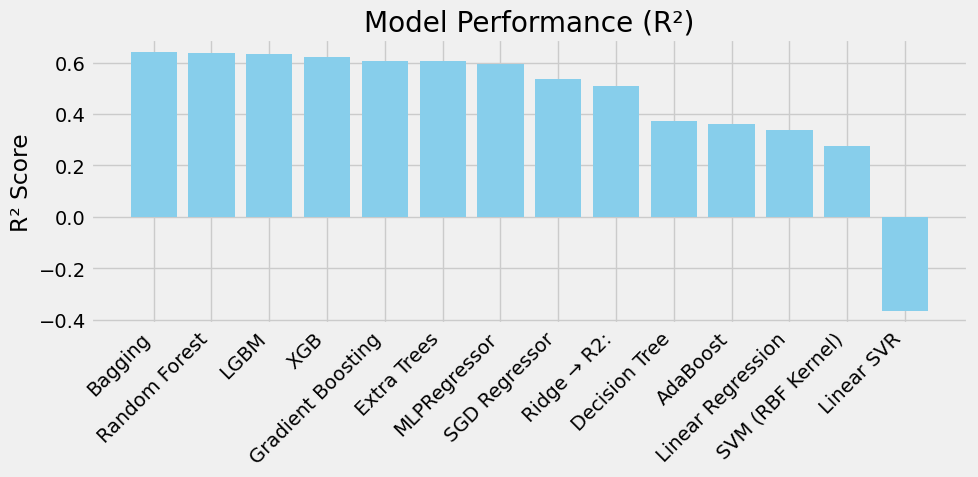

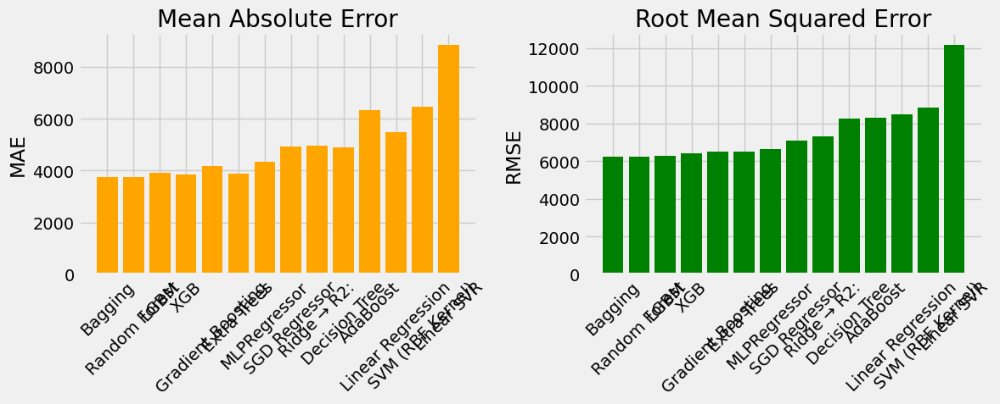

In [155]:
import matplotlib.pyplot as plt


results_df = pd.DataFrame(results, columns=["Model", "R2", "MAE", "RMSE"])
results_df = results_df.sort_values(by="R2", ascending=False)

# table
print("\n=== Model Performance Comparison ===")
print(results_df)

# Bar Chart for R²
plt.figure(figsize=(10, 5))
plt.bar(results_df["Model"], results_df["R2"], color="skyblue")
plt.xticks(rotation=45, ha="right")
plt.ylabel("R² Score")
plt.title("Model Performance (R²)")
plt.tight_layout()
plt.show()


fig, axes = plt.subplots(1, 2, figsize=(12, 5))#  MAE and RMSE charts

axes[0].bar(results_df["Model"], results_df["MAE"], color="orange")
axes[0].set_title("Mean Absolute Error")
axes[0].tick_params(axis='x', rotation=45)
axes[0].set_ylabel("MAE")

axes[1].bar(results_df["Model"], results_df["RMSE"], color="green")
axes[1].set_title("Root Mean Squared Error")
axes[1].tick_params(axis='x', rotation=45)
axes[1].set_ylabel("RMSE")

plt.tight_layout()
plt.show()

voting regressor

In [156]:
from sklearn.ensemble import VotingRegressor

#top models
top_models = [
    ("RandomForest", RandomForestRegressor(n_estimators=200, random_state=42, n_jobs=-1)),
    ("XGB", xgb.XGBRegressor(n_estimators=300, learning_rate=0.1, random_state=42, n_jobs=-1)),
    ("LGBM", lgb.LGBMRegressor(n_estimators=300, learning_rate=0.1, random_state=42, n_jobs=-1)),
    ("ExtraTrees", ExtraTreesRegressor(n_estimators=300, random_state=42, n_jobs=-1)),
    ("GradientBoosting", GradientBoostingRegressor(n_estimators=300, random_state=42))
]

# Assigning weights ( manually set from your R² results)

weights = [0.95, 0.92, 0.91, 0.93, 0.89]

# Creating the Voting Regressor
voting_model = VotingRegressor(estimators=top_models, weights=weights)

# Pipeline with preprocessing
final_pipe = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', voting_model)
])

final_pipe.fit(X_train, y_train)

y_pred = final_pipe.predict(X_test)
print("VotingRegressor → R2:", r2_score(y_test, y_pred),
      "MAE:", mean_absolute_error(y_test, y_pred),
      "RMSE:", np.sqrt(mean_squared_error(y_test, y_pred)))

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000360 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 880
[LightGBM] [Info] Number of data points in the train set: 1600, number of used features: 69
[LightGBM] [Info] Start training from score 13210.211875
VotingRegressor → R2: 0.6534053454580736 MAE: 3664.9642331589375 RMSE: 6126.850191256145


In [157]:
def get_feature_importance(pipe):

    # feature names from preprocessing
    ohe_features = pipe.named_steps['preprocessor'].transformers_[1][1]['onehot'].get_feature_names_out(categorical_features)
    feature_names = numeric_features + list(ohe_features)

    model = pipe.named_steps['model']

    if hasattr(model, "feature_importances_"):
        return pd.Series(model.feature_importances_, index=feature_names)
    elif hasattr(model, "coef_"):
        coef = model.coef_
        if coef.ndim > 1:
            coef = coef.ravel()
        return pd.Series(coef, index=feature_names)
    else:
        return None

# Individual model feature importances
for model_name, pipe in fitted_pipes.items():
    fi = get_feature_importance(pipe)
    if fi is not None:
        print(f"\n=== Top 15 Features for {model_name} ===")
        print(fi.abs().sort_values(ascending=False).head(15))
    else:
        print(f"\n{model_name} does not gibe importances or coefficients.")

# Combined average importance
all_features = list(set().union(*[get_feature_importance(pipe).index
                                  for pipe in fitted_pipes.values()
                                  if get_feature_importance(pipe) is not None]))

feature_matrix = pd.DataFrame(index=all_features)

for model_name, pipe in fitted_pipes.items():
    fi = get_feature_importance(pipe)
    if fi is not None:
        feature_matrix[model_name] = fi.reindex(all_features).fillna(0)
    else:
        feature_matrix[model_name] = 0

feature_matrix["Average_Importance"] = feature_matrix.abs().mean(axis=1)
feature_matrix = feature_matrix.sort_values(by="Average_Importance", ascending=False)

print("\n=== Top 15 Features Across All Models ===")
print(feature_matrix.head(15))


=== Top 15 Features for Linear Regression ===
make_SUABRU                      87373.762079
make_isuzu ftr                   61959.377867
make_300zx twin turbo z32        40680.576752
make_model a                     40444.613885
make_fairlane ranch wagon        34036.452406
make_benz s550                   29054.105389
make_f-350 sd                    28510.404124
make_bus                         28111.569934
make_expedition max              26360.322980
city_great falls, MT             25724.010123
make_f150 super cab raptor       25560.764772
make_duramax high country        25174.749447
make_Scion TC                    24441.638109
make_tahoe ltz 4x4               24315.805090
make_silverado 2500hd duramax    23022.989553
dtype: float64

SVM (RBF Kernel) does not gibe importances or coefficients.

=== Top 15 Features for Linear SVR ===
title_status_clean        820.985614
transmission_automatic    771.985614
fuel_gas                  729.985614
size_full-size            719.580170

In [158]:
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import numpy as np
import pandas as pd


X_all = df.drop(columns=['price'])
y_all = df['price']

# Predicion oft prices for the entire dataset
y_pred_all = final_pipe.predict(X_all)

# Evaluating performance
r2_all = r2_score(y_all, y_pred_all)
mae_all = mean_absolute_error(y_all, y_pred_all)
rmse_all = np.sqrt(mean_squared_error(y_all, y_pred_all))

print(f"Performance on Full Dataset:")
print(f"R²: {r2_all:.4f}")
print(f"MAE: {mae_all:,.2f}")
print(f"RMSE: {rmse_all:,.2f}")

#prediction vs prioce of the cards
comparison_df = df.copy()
comparison_df['Predicted_Price'] = y_pred_all
comparison_df['Error'] = comparison_df['Predicted_Price'] - comparison_df['price']


print(" Sample Predictions vs Actual")
print(comparison_df[['price', 'Predicted_Price', 'Error']].head(20))


comparison_df.to_csv("car_price_predictions_comparison.csv", index=False)
print("\nFull prediction comparison saved to car_price_predictions_comparison.csv")

Performance on Full Dataset:
R²: 0.9022
MAE: 1,772.27
RMSE: 3,348.91
 Sample Predictions vs Actual
    price  Predicted_Price        Error
0    1500      2836.854387  1336.854387
1    8900      8795.282360  -104.717640
2    7995      8831.731824   836.731824
3    6995      6097.570359  -897.429641
4   20990     20716.541470  -273.458530
5    4950      5069.799818   119.799818
6    6850      7284.078477   434.078477
7    7995      6566.504407 -1428.495593
8    4995      5806.162644   811.162644
9   12995     12120.276191  -874.723809
11   3195      6730.703127  3535.703127
12   8000      7758.046273  -241.953727
14  33980     32532.660417 -1447.339583
17  16900     16884.117404   -15.882596
18   6995      7061.335993    66.335993
19  10995     11774.631703   779.631703
21  39000     35841.876021 -3158.123979
24   8900     10466.231109  1566.231109
25  23990     27395.273749  3405.273749
26  40990     37853.894566 -3136.105434

Full prediction comparison saved to car_price_predictions_co

Single car price predictor

In [166]:
def predict_price(car_features: dict):
    input_df = pd.DataFrame([car_features])
    return final_pipe.predict(input_df)[0]

#eg car, change value for change in price
example_car = {
    'city': 'newyork',
    'year': 2010,
    'manufacturer': 'toyota',
    'make': 'corolla',
    'condition': 'good',
    'cylinders': '4 cylinders',
    'fuel': 'diesel',
    'odometer': 60000,
    'title_status': 'clean',
    'transmission': 'manual',
    'drive': 'fwd',
    'size': 'mid-size',
    'type': 'sedan',
    'paint_color': 'white',
    'lat': 40.7128,
    'long': -71.0060
}

predicted_price = predict_price(example_car)
print(f"Predicted Price: ${predicted_price:,.2f}")
print()

Predicted Price: $13,208.74

